In [1]:
import h5py
import math
import bisect
import numpy as np
from scipy import stats

In [2]:
import matplotlib
import matplotlib.font_manager
import matplotlib.pyplot as plt
matplotlib.font_manager._rebuild()
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": ["Helvetica"]})
matplotlib.rc('text', usetex=True)
matplotlib.rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]
# for Palatino and other serif fonts use:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Palatino"],
})
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png', 'pdf')

In [3]:
class Data:
    def __init__(self, file):
        self.savefigs = True
        self.x = file['ScalingFunction/Variable']
        self.realPlus = file['ScalingFunction/Real']
        self.imagPlus = file['ScalingFunction/Imag']
        #self.realPlus = file['ScalingFunction/RealPlus']
        #self.imagPlus = file['ScalingFunction/ImagPlus']
        #self.realMinus = file['ScalingFunction/RealMinus']
        #self.imagMinus = file['ScalingFunction/ImagMinus']
        
        self.uv = file['ScalingFunction'].attrs['Upper Cutoff Bubble']
        self.ir = file['ScalingFunction'].attrs['Lower Cutoff Bubble']
        self.b = file['ScalingFunction'].attrs['b']
        self.vF = file['ScalingFunction'].attrs['vF']
        self.prec = file['ScalingFunction'].attrs['Precision']
        self.steps = file['ScalingFunction'].attrs['Steps']
        self.extrap = file['ScalingFunction'].attrs['extraPolate']
            
        self.omega = file['Bubble/omega']
        self.omegaReal = file['Bubble/omegReal']
        self.omegaImag = file['Bubble/omegImag']
        self.omegqr = file['Bubble'].attrs['Freq qr']
        self.omegqt = file['Bubble'].attrs['Freq qt']
        self.qr = file['Bubble/qr']
        self.radReal = file['Bubble/radReal']
        self.radImag = file['Bubble/radImag']
        self.radOmeg = file['Bubble'].attrs['Radial omega']
        self.radqt = file['Bubble'].attrs['Radial qt']
        self.qt = file['Bubble/qt']
        self.tangReal = file['Bubble/tangReal']
        self.tangImag = file['Bubble/tangImag']
        self.tangOmeg = file['Bubble'].attrs['Tangential omega']
        self.tangqr = file['Bubble'].attrs['Tangential qr']
        
        self.freqs = file['SelfEnergy/freqs']
        self.moms = file['SelfEnergy/rads']
        #self.SE = np.array(file['SelfEnergy/SE']).T
        self.kr = file['SelfEnergy'].attrs['kr']
        self.kt = file['SelfEnergy'].attrs['kt']
        
    def logderiv(self,x,f):
        farr = []
        xarr = []
        for i in range(len(x)-1):
            if (f[i]==0 or f[i+1]==0):
                continue
                #print(x[i])
            else:
                a = math.log(abs(f[i+1]))-math.log(abs(f[i]))
                b = math.log(abs(x[i+1]))-math.log(abs(x[i]))
                if b==0:
                    print(x[i])
                else:
                    farr.append(a/b)
                    xarr.append(x[i])
        return farr, xarr
    
    def xarr(self,x,f):
        arr = []
        for i in range(len(x)-1):
            if f[i]==0:
                continue
            else:
                arr.append(abs(x[i]))
        return arr

In [4]:
class Bubble(Data):
    def __init__(self,file):
        Data.__init__(self,file)    
    
    def scalingPlusReal(self):
        def f(x):
            if x>0:
                return 2**(3/4)/(2*math.pi)*(abs(x))**(1/4)+3*2**(1/4)/(4*math.pi)*(abs(x))**(-1/4)*1/2
            else:
                return 2**(5/4)/(2*math.pi)*(abs(x))**(1/4)+3*2**(1/4)/(4*math.pi)*(abs(x))**(-1/4)*1/math.sqrt(2)
        f2 = np.vectorize(f)
        x = np.linspace(-1000, 1000, 1000)
        #plt.plot(x, f2(x),label='Expansion')
        plt.plot(self.x,self.realPlus, label = 'Full function')
        plt.xlabel(r'$x$',fontsize=20)
        plt.ylabel(r'$Re I(x)$',fontsize=20)
        plt.xlim([-10,10])
        plt.ylim([0.0,1.0])
        #plt.legend()
        plt.savefig('Documents/figs/scalingFunctionReal.pdf',bbox_inches="tight")
        plt.show()
    
    def scalingPlusImag(self):
        def g(x):
            if x>0:
                return -2**(3/4)/(2*math.pi)*(abs(x))**(1/4)-3*2**(1/4)/(4*math.pi)*(abs(x))**(-1/4)*1/2
                #return -3*2**(1/4)/(4*math.pi)*(abs(x))**(-1/4)*1/2
            else:
                return 0*2**(5/4)/(2*math.pi)*(abs(x))**(1/4)
        g2 = np.vectorize(g)
        x = np.linspace(-1000, 1000, 1000)
        #plt.plot(x, g2(x),label='Expansion')
        plt.plot(self.x,self.imagPlus,label='Full function')
        plt.xlabel(r'$x$',fontsize=20)
        plt.ylabel(r'$Im I(x)$',fontsize=20)
        plt.xlim([-10,10])
        plt.ylim([-1.0,0.1])
        #plt.legend()
        plt.savefig('Documents/figs/scalingFunctionImag.pdf',bbox_inches="tight")
        plt.show()
        
    def scalingMinusReal(self):
        plt.scatter(self.x,self.realMinus,s=2)
        plt.xlabel(r'$x$',fontsize=20)
        plt.ylabel(r'$Re\delta I_t^{(-)}(x)$',fontsize=20)
        plt.show()
        
    def scalingMinusImag(self):
        plt.scatter(self.x,self.imagMinus,s=2)
        plt.xlabel(r'$x$',fontsize=20)
        plt.ylabel(r'$Im\delta I_t^{(-)}(x)$',fontsize=20)
        plt.show()
    
    def freqRealPlot(self):
        def f(x):
            return self.prefactor*math.sqrt(math.sqrt(abs(x)))*(1+math.sqrt(2))
        f2 = np.vectorize(f)
        x = np.linspace(-1, 1, 1000)
        #plt.plot(x, f2(x),label='Exact formula')
        #plt.plot(self.omega,self.omegaReal, label = 'Numerical result')
        plt.plot(self.omega,self.omegaReal)
        plt.xlabel(r'$\omega$', fontsize=20)
        plt.ylabel(r'$Re\delta\Pi(\omega,q_r=$' + str(self.omegqr) + '$, q_t=$' + str(self.omegqt) + '$)$', fontsize=20)
        plt.legend()
        #plt.xlim([-1,1])
        #plt.ylim([0.0,1.0])
        if self.savefigs:
            plt.savefig('Documents/figs/quarticRealFrequency1.pdf',bbox_inches="tight")
        plt.show()
        
    def freqRealScatter(self):
        plt.scatter(self.omega,self.omegaReal,s=10)
        plt.xlabel(r'$\omega$', fontsize=20)
        plt.ylabel(r'$Re\delta\Pi(\omega,q_r=$' + str(self.omegqr) + '$, q_t=$' + str(self.omegqt) + '$)$', fontsize=20)
        plt.legend()
        #plt.xlim([-1,1])
        #plt.ylim([0.0,1.0])
        if self.savefigs:
            plt.savefig('Documents/figs/quarticRealFrequencyScatter.pdf',bbox_inches="tight")
        plt.show()
        
    def freqImagPlot(self):
        def g(x):
            if (x<0):
                return self.prefactor*math.sqrt(math.sqrt(abs(x))) 
            elif (x>0):
                return -self.prefactor*math.sqrt(math.sqrt(abs(x))) 
        g2 = np.vectorize(g)
        x = np.linspace(-1, 1, 1000)
        #plt.plot(x, g2(x),label='Exact formula')
        plt.plot(self.omega,self.omegaImag)
        plt.xlabel(r'$\omega$', fontsize=20)
        plt.ylabel(r'$Im\delta\Pi(\omega,q_r=$' + str(self.omegqr) + '$, q_t=$' + str(self.omegqt) + '$)$', fontsize=20)
        plt.legend()
        #plt.xlim([-1,1])
        #plt.ylim([0.0,1.0])
        if self.savefigs:
            plt.savefig('Documents/figs/quarticImagFrequency1.pdf',bbox_inches="tight")
        plt.show()
        
    def radialRealPlot(self):
        prefactor = 1.0/(2*math.pi)
        def h(x):
            if (x<0):
                return prefactor*math.sqrt(math.sqrt(abs(x))) 
            elif (x>0):
                return prefactor*math.sqrt(math.sqrt(abs(x)))*math.sqrt(2)
        h2 = np.vectorize(h)
        x = np.linspace(-1, 1, 10000000)
        plt.plot(x, h2(x),label='Exact formula')
        #plt.plot(self.qr,self.radReal)
        plt.xlabel(r'$q_r$', fontsize=20)
        plt.ylabel(r'$\delta\Pi(q_r,0,0)$', fontsize=20)
        #plt.legend()
        plt.xlim([-1,1])
        plt.ylim([0.0,0.25])
        #if self.savefigs:
        plt.savefig('Documents/figs/radialBubble.pdf',bbox_inches="tight")
        plt.show()
    
    def radialImagPlot(self):
        plt.plot(self.qr,self.radImag)
        plt.xlabel(r'$q_r$', fontsize=20)
        plt.ylabel(r'$Im\delta\Pi(\omega=$' + str(self.radOmeg) + '$,q_r, q_t=$' + str(self.radqt) + '$)$', fontsize=20)
        plt.legend()
        plt.xlim([-1,1])
        plt.ylim([0.0,1.0])
        if self.savefigs:
            plt.savefig('Documents/figs/quarticImagRadial1.pdf',bbox_inches="tight")
        plt.show()
        
    def tangentialRealPlot(self):
        plt.plot(self.qt,self.tangReal,color = '#EF7F1A')
        plt.xlabel(r'$q_t$', fontsize=20)
        plt.ylabel(r'$Re\delta\Pi(\omega=$' + str(self.tangOmeg) + '$,q_r=$' + str(self.tangqr) + '$,qt)$', fontsize=20)
        #plt.legend()
        plt.xlim([0,1])
        plt.ylim([0.0,0.2])
        if self.savefigs:
            plt.savefig('Documents/figs/quarticRealTangential1.pdf',bbox_inches="tight")
        plt.show()
    
    def tangentialImagPlot(self):
        plt.plot(self.qt,self.tangImag, label = 'Numerical result')
        plt.xlabel(r'$q_t$', fontsize=20)
        #plt.ylabel(r'$Im\delta\Pi(\omega=$' + str(2*self.epsilon) + '$,q_r=$' + str(self.epsilon) + '$,q_t)$', fontsize=20)
        plt.ylabel(r'$Re\delta\Pi(\omega=$' + str(2*self.tangOmeg) + '$q_r=$' + str(self.tangqr) + '$,qt)$', fontsize=20)
        #plt.legend()
        #plt.xlim([-1,1])
        #plt.ylim([0.0,1.0])
        if self.savefigs:
            plt.savefig('Documents/figs/quarticImagTangential1.pdf',bbox_inches="tight")
        plt.show()
        


In [5]:
class SelfEnergy(Data):
    def positiveSelfEnergy(self,i):
        plt.scatter(self.freqs,self.SE[i],s=10)
        #plt.scatter(self.freqs,self.SENeg,s=10)
        plt.xlabel(r'$\omega$',fontsize=20)
        plt.ylabel(r'$Im\Sigma_H(\omega)$',fontsize=20)
        plt.xlim([self.freqs[0],self.freqs[-1]])
        plt.ylim([-0.08,0])
        #plt.savefig('Documents/figs/quarticImagSelfEnergyPos.pdf',bbox_inches="tight")
        plt.show()
    
    def plotSelfEnergykr(self,i):
        plt.scatter(self.freqs,self.SE[i],s=10,label= '$k_r = $'+str(self.moms[i]))
        plt.xlabel(r'$\omega$',fontsize=20)
        plt.ylabel(r'$Im\Sigma(\omega,k_r,k_t)$',fontsize=20)
        #plt.xlim([-1,1])
        plt.axvline(-self.moms[i],linestyle = 'dashed',color = 'black')
        plt.axvline(self.moms[i],linestyle = 'dashed',color = 'black')
        #plt.ylim([1e-5,0.1])
        plt.legend()
        #plt.savefig('Documents/figs/quarticImagSelfEnergyOmega.pdf',bbox_inches="tight")
        plt.show()
        
    def logDPlotkr(self,i):
        farr, xarr = self.logderiv(self.freqs,self.SE[i])
        plt.scatter(xarr,farr,s=10,label = '$k_r = $'+str(self.moms[i]))
        plt.xlabel(r'$\omega$',fontsize=20)
        plt.ylabel(r'$\frac{d\log(Im\Sigma(\omega,k_r,k_t)}{d\log\omega}$',fontsize=20)
        #plt.axvline(-self.kr,linestyle = 'dashed',color = 'black')
        plt.xlim([-1,1])
        plt.ylim([0.0,5])
        #plt.axvline(0.0,linestyle = 'dotted',color = 'black')
        plt.axvline(-self.moms[i],linestyle = 'dashed',color = 'black')
        plt.axvline(self.moms[i],linestyle = 'dashed',color = 'black')
        plt.axhline(1.0,linestyle = 'dotted',color = 'black')
        plt.axhline(2.0,linestyle = 'dotted',color = 'black')
        plt.legend()
        #plt.savefig('Documents/figs/quarticImagSelfEnergyOmegalogd.pdf',bbox_inches="tight")
        plt.show()
    
    
    def plotSelfEnergykt(self,i):
        plt.scatter(self.freqs,self.SE[i],s=10,label = '$k_t = $'+str(self.moms[i]))
        plt.xlabel(r'$\omega$',fontsize=20)
        plt.ylabel(r'$Im\Sigma(\omega,k_r,k_t)$',fontsize=20)
        #plt.xlim([-1,1])
        plt.legend()
        #plt.savefig('Documents/figs/quarticImagSelfEnergykt1.pdf',bbox_inches="tight")
        plt.show() 
        
    def logDPlotkt(self,i):
        farr, xarr = self.logderiv(self.freqs,self.SE[i])
        plt.scatter(self.xarr,self.farr,s=10,label = '$k_t = $'+str(self.moms[i]))
        plt.xlabel(r'$\omega$',fontsize=20)
        plt.ylabel(r'$\frac{d\log(Im\Sigma(\omega,k_r,k_t)}{d\log(\omega)}$',fontsize=20)
        #plt.axvline(-self.kr,linestyle = 'dashed',color = 'black')
        plt.xlim([-10,10])
        plt.ylim([0.0,5])
        plt.axvline(0.0,linestyle = 'dotted',color = 'black')
        plt.axvline(-self.kt**4,linestyle = 'dashed',color = 'black')
        plt.axvline(self.kt**4,linestyle = 'dashed',color = 'black')
        plt.axhline(2.0,linestyle = 'dotted',color = 'black')
        plt.legend()
        #plt.xscale('log')
        #plt.yscale('log')
        #plt.savefig('Documents/figs/quarticImagSelfEnergyDkt1.pdf',bbox_inches="tight")
        plt.show()
    

In [6]:
foo = Bubble(h5py.File('quarticReal/scalingBubble4.h5','r'))

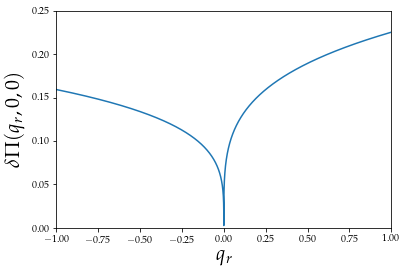

In [7]:
foo.radialRealPlot()

In [59]:
sel = SelfEnergy(h5py.File('quarticReal/tangentialDependence.h5','r'))
omega = np.array(sel.freqs)
kt = np.array(sel.moms)
SE = sel.SE

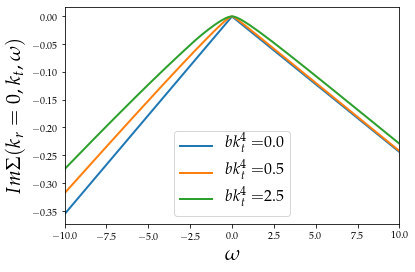

In [62]:
plt.plot(sel.freqs,0.5*np.array(sel.SE[0]),linewidth=2,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[0])**4,1)))
plt.plot(sel.freqs,0.5*np.array(sel.SE[10]),linewidth=2,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[10])**4,1)))
plt.plot(sel.freqs,0.5*np.array(sel.SE[15]),linewidth=2,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[15])**4,1)))
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(k_r=0,k_t,\omega)$',fontsize=20)
plt.xlim([-10,10])
#plt.ylim([1e-5,0.1])
plt.legend(fontsize=16,loc=8)
plt.savefig('Documents/figs/imagSelfEnergyTangential1.pdf',bbox_inches="tight")
plt.show()

In [50]:
sel = SelfEnergy(h5py.File('quarticReal/imagRadial.h5','r'))

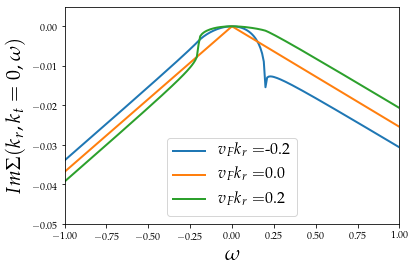

In [58]:
plt.plot(sel.freqs,0.5*np.array(sel.SE[10]),linewidth=2,label= '$v_F k_r = $'+str(round(sel.moms[10],2)))
plt.plot(sel.freqs,0.5*np.array(sel.SE[30]),linewidth=2,label= '$v_F k_r = $'+str(round(sel.moms[30],2)))
plt.plot(sel.freqs,0.5*np.array(sel.SE[50]),linewidth=2,label= '$v_F k_r = $'+str(round(sel.moms[50],2)))
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(k_r,k_t=0,\omega)$',fontsize=20)
plt.xlim([-1,1])
plt.ylim([-0.05,0.005])
plt.legend(fontsize=16,loc=8)
plt.savefig('Documents/figs/imagSelfEnergyRadial1.pdf',bbox_inches="tight")
plt.show()

In [6]:
f = Bubble(h5py.File('quarticReal/scalingBubble4.h5','r'))

findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.


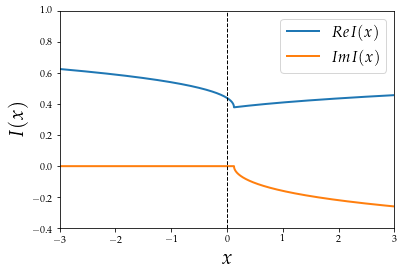

In [7]:
x = f.x
real = f.realPlus
imag = f.imagPlus

plt.plot(x,real,linewidth=2, label = r'$Re I(x)$')
plt.plot(x,imag,linewidth=2, label = r'$Im I(x)$')
plt.xlabel(r'$x$',fontsize=20)
plt.ylabel(r'$I(x)$',fontsize=20)
plt.axvline(0.0,linewidth=1,color='black',linestyle='--')
plt.xlim([-3,3])
plt.ylim([-0.4,1.0])
plt.legend(fontsize=16)
plt.savefig('Documents/figs/scalingFunctionComplex.pdf',bbox_inches="tight")
plt.show()

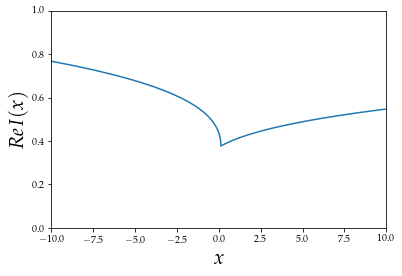

In [27]:
f.scalingPlusReal()

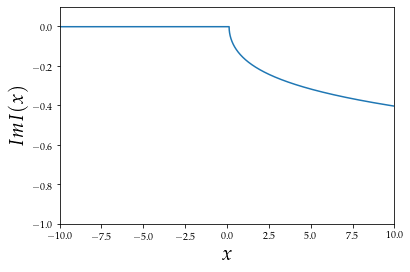

In [28]:
f.scalingPlusImag()

In [8]:
f = h5py.File("quarticReal/TangentialScaling1.h5",'r')
kt = np.array(f['Funcx/args'])
posx = np.array(f['Funcx/Posf'])
negx = np.array(f['Funcx/Negf'])

In [10]:
slope, intercept, r, p, std_err = stats.linregress(kt[:5]**2,posx[:5])
print(slope)

0.0001899136543722938


In [11]:
slope, intercept, r, p, std_err = stats.linregress(kt[:5]**2,negx[:5])
print(slope)

-0.024190911914181497


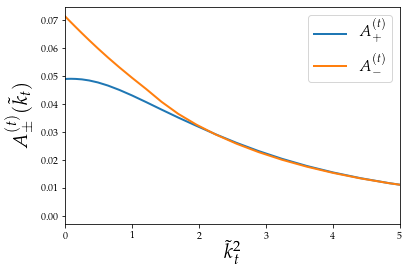

In [41]:
ktq = kt**2

plt.plot(ktq,posx,linewidth=2,label=r'$A^{(t)}_+$')
plt.plot(ktq,negx,linewidth=2,label=r'$A^{(t)}_-$')
plt.xlabel(r'$\tilde{k}_t^2$',fontsize=20)
plt.ylabel(r'$A^{(t)}_\pm(\tilde{k}_t)$',fontsize=20)
plt.xlim([0.0,5.0])
#plt.ylim([0.0,0.08])
plt.legend(fontsize=16)
plt.savefig('Documents/figs/TangentialScalingQuad.pdf',bbox_inches="tight")
plt.show()

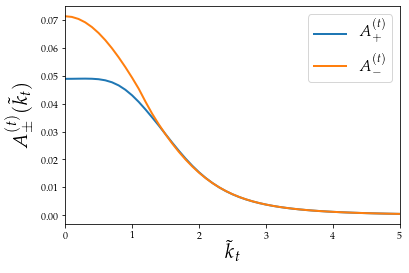

In [36]:
plt.plot(kt,posx,linewidth=2,label=r'$A^{(t)}_+$')
plt.plot(kt,negx,linewidth=2,label=r'$A^{(t)}_-$')
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$A^{(t)}_\pm(\tilde{k}_t)$',fontsize=20)
plt.xlim([0.0,5.0])
#plt.ylim([0.0,0.08])
plt.legend(fontsize=16)
plt.savefig('Documents/figs/TangentialScaling1.pdf',bbox_inches="tight")
plt.show()

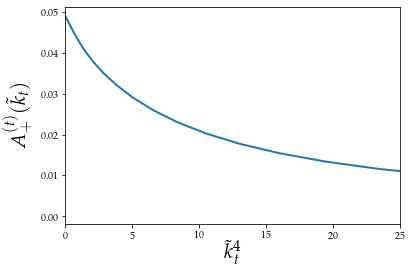

In [93]:
ktq = kt**4
plt.plot(ktq,posx,linewidth=2)
plt.xlabel(r'$\tilde{k}_t^4$',fontsize=20)
plt.ylabel(r'$A^{(t)}_+(\tilde{k}_t)$',fontsize=20)
plt.xlim([0.0,25.0])
#plt.ylim([0.0,0.08])
plt.savefig('Documents/figs/TangentialPositive.pdf',bbox_inches="tight")

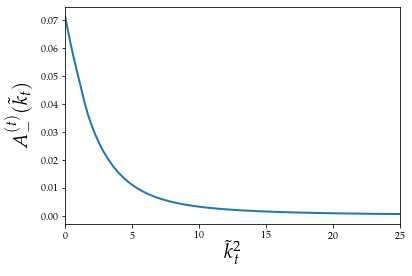

In [94]:
ktquad = kt**2
plt.plot(ktquad,negx,linewidth=2)
plt.xlabel(r'$\tilde{k}_t^2$',fontsize=20)
plt.ylabel(r'$A^{(t)}_-(\tilde{k}_t)$',fontsize=20)
plt.xlim([0.0,25.0])
plt.savefig('Documents/figs/TangentialNegative.pdf',bbox_inches="tight")

In [24]:
f = h5py.File("quarticReal/RadialScaling5.h5",'r')
kr = np.array(f['Funcx/args'])
posx = np.array(f['Funcx/Posf'])
negx = np.array(f['Funcx/Negf'])

(-5.0, 5.0)

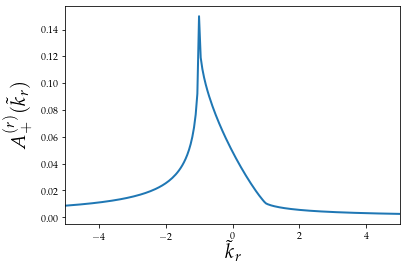

In [7]:
plt.plot(kr,posx,linewidth=2)
#plt.scatter(kr,posx,s=5)
plt.xlabel(r'$\tilde{k}_r$',fontsize=20)
plt.ylabel(r'$A^{(r)}_+(\tilde{k}_r)$',fontsize=20)
plt.xlim([-5.0,5.0])
#plt.ylim([0.0,0.08])
#plt.savefig('Documents/figs/RadialPos.pdf',bbox_inches="tight")

(-5.0, 5.0)

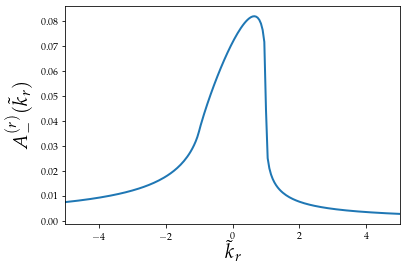

In [8]:
plt.plot(kr,negx,linewidth=2)
plt.xlabel(r'$\tilde{k}_r$',fontsize=20)
plt.ylabel(r'$A^{(r)}_-(\tilde{k}_r)$',fontsize=20)
plt.xlim([-5.0,5.0])
#plt.ylim([0.0,0.08])
#plt.savefig('Documents/figs/RadialNeg.pdf',bbox_inches="tight")

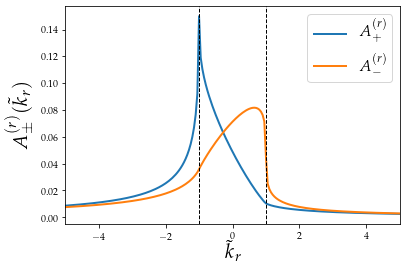

In [33]:
plt.plot(kr,posx,linewidth=2,label=r'$A^{(r)}_+$')
plt.plot(kr,negx,linewidth=2,label=r'$A^{(r)}_-$')
#plt.scatter(kr,posx,s=5)
plt.xlabel(r'$\tilde{k}_r$',fontsize=20)
plt.ylabel(r'$A^{(r)}_\pm(\tilde{k}_r)$',fontsize=20)
plt.axvline(-1.0,linewidth=1,color='black',linestyle='--')
plt.axvline(1.0,linewidth=1,color='black',linestyle='--')
plt.xlim([-5.0,5.0])
#plt.ylim([0.0,0.08])
plt.legend(fontsize=16)
plt.savefig('Documents/figs/RadialScaling1.pdf',bbox_inches="tight")
plt.show()

In [18]:
f = h5py.File("quarticReal/imagTangentialFunc2.h5",'r')
kr = f['Funcx/args']
posx = f['Funcx/Posf']
negx = f['Funcx/Negf']

Text(0.0, 0.06, '$0.051=const.$')

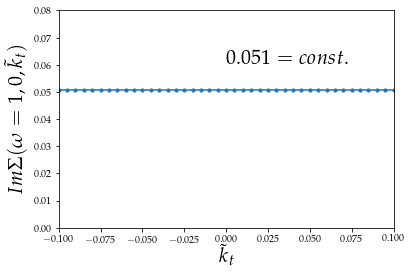

In [30]:
slopePos, interceptPos, r, p, std_err = stats.linregress(kr, posx)
def myfuncPos(x):
    return slopePos * x + interceptPos
mymodelPos = list(map(myfuncPos, kr))


plt.scatter(kr,posx,s=10)
plt.plot(kr,mymodelPos)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([-0.1,0.1])
plt.ylim([0.0,0.08])
plt.text(0.0,0.06,r'$0.051=const.$',fontsize=20)
#plt.savefig('Documents/figs/FuncPos.pdf',bbox_inches="tight")

In [22]:
print(slopePos)
print(interceptPos)

-1.208202483561774e-18
0.05084304526282166


Text(0.0, 0.06, '$0.074=const.$')

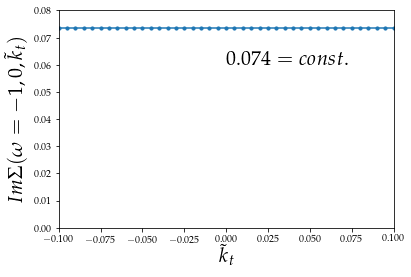

In [31]:
slopeNeg, interceptNeg, r, p, std_err = stats.linregress(kr, negx)
def myfuncNeg(x):
    return slopeNeg * x + interceptNeg
mymodelNeg = list(map(myfuncNeg, kr))

plt.scatter(kr,negx,s=10)
plt.plot(kr,mymodelNeg)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=-1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([-0.1,0.1])
plt.ylim([0.0,0.08])
plt.text(0.0,0.06,r'$0.074=const.$',fontsize=20)
#plt.savefig('Documents/figs/FuncNeg.pdf',bbox_inches="tight")

In [26]:
print(slopeNeg)
print(interceptNeg)

1.1805337243962373e-20
0.07352283256790522


In [196]:
f = h5py.File("quarticReal/imagTangentialFunc7.h5",'r')
kr = np.array(f['Funcx/args'])
posx = np.array(f['Funcx/Posf'])
negx = np.array(f['Funcx/Negf'])

In [69]:
f = h5py.File("quarticReal/imagTangentialFuncDC1.h5",'r')
kr = np.array(f['Funcx/args'])
posx = np.array(f['Funcx/Posf'])
negx = np.array(f['Funcx/Negf'])

In [70]:
negx

array([ 0.00000000e+00, -2.61443818e-06, -1.04643416e-05, -2.34825030e-05,
       -4.17614689e-05, -6.52918853e-05, -9.40367884e-05, -1.28087024e-04,
       -1.67209345e-04, -2.11656324e-04, -2.61267072e-04, -3.16092716e-04,
       -3.76035437e-04, -4.41234539e-04, -5.11574944e-04, -5.87065371e-04,
       -6.67797501e-04, -7.53694461e-04, -8.44561828e-04, -9.40655754e-04,
       -1.04186444e-03, -1.14821260e-03, -1.25955582e-03, -1.37605470e-03,
       -1.49749466e-03, -1.62403132e-03, -1.75558024e-03, -1.89211481e-03,
       -2.03364705e-03, -2.18009798e-03, -2.33141879e-03, -2.48779580e-03,
       -2.64918028e-03, -2.81503306e-03, -2.98587207e-03, -3.16154090e-03,
       -3.34196603e-03, -3.52709519e-03, -3.71696836e-03, -3.91167824e-03,
       -4.11147113e-03, -4.31581938e-03, -4.52263212e-03, -4.73543440e-03,
       -4.95268897e-03, -5.17437626e-03, -5.40040888e-03, -5.63079688e-03,
       -5.86554380e-03, -6.10442835e-03, -6.34754518e-03, -6.59478171e-03,
       -6.84611613e-03, -

(-0.01, 0.001)

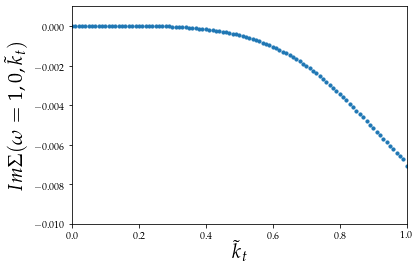

In [51]:
plt.scatter(kr,posx,s=10)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([0,1])
plt.ylim([-0.01,0.001])

(-0.03, 0.001)

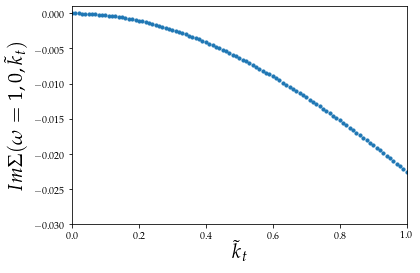

In [55]:
plt.scatter(kr,negx,s=10)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([0,1])
plt.ylim([-0.03,0.001])

In [75]:
f = h5py.File("quarticReal/imagTangentialFuncSubtract.h5",'r')
kr = np.array(f['Funcx/args'])
posx = np.array(f['Funcx/Posf'])
negx = np.array(f['Funcx/Negf'])

(-0.01, 0.001)

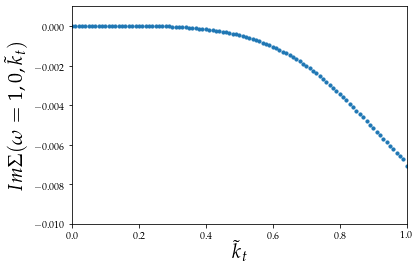

In [57]:
plt.scatter(kr,posx,s=10)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([0,1])
plt.ylim([-0.01,0.001])

(-0.03, 0.001)

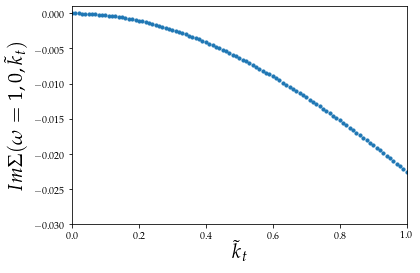

In [59]:
plt.scatter(kr,negx,s=10)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([0,1])
plt.ylim([-0.03,0.001])

In [25]:
logkr = []
logPos = []
for i in range(len(kr)-1):
    logkr.append(math.log(kr[i+1]))
    logPos.append(math.log(abs(posx[i+1])))   

(-0.01, 0.001)

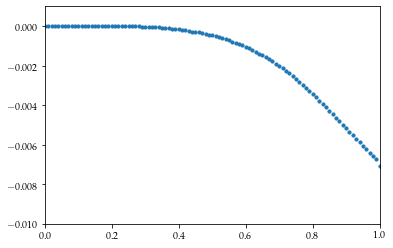

In [34]:
plt.scatter(kr,posx,s=10)
plt.xlim([0,1])
plt.ylim([-0.01,0.001])

Text(0, 0.5, '$\\log(Im\\delta\\Sigma(\\omega=1,0,\\tilde{k}_t))$')

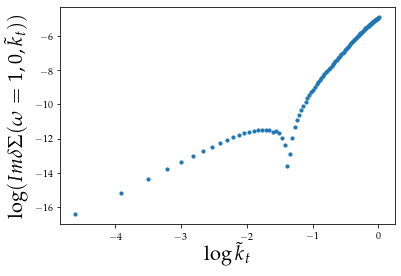

In [35]:
slopePos, interceptPos, r, p, std_err = stats.linregress(logkr[0:101], logPos[0:101])
def myfuncPos(x):
    return slopePos * x - interceptPos
mymodelPos = list(map(myfuncPos, logkr)) 

plt.scatter(logkr[0:101],logPos[0:101],s=10)
#plt.plot(logkr,mymodelPos)
plt.xlabel(r'$\log\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$\log(Im\delta\Sigma(\omega=1,0,\tilde{k}_t))$',fontsize=20)
#plt.xlim([0,1])
#plt.ylim([-0.01,0.003])
#plt.text(0.6,-0.002,r'$-0.008\tilde{k}_t^4$',fontsize=20)

Text(0.6, -0.002, '$-0.008\\tilde{k}_t^4$')

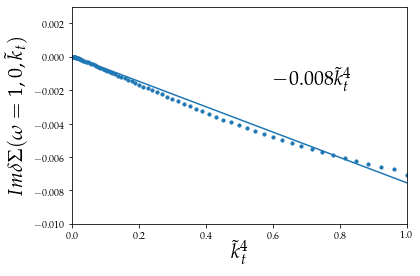

In [30]:
ktq = kr**4

slopePos, interceptPos, r, p, std_err = stats.linregress(ktq[0:101], posx[0:101])
def myfuncPos(x):
    return slopePos * x - interceptPos
mymodelPos = list(map(myfuncPos, ktq)) 

plt.scatter(ktq,posx,s=10)
plt.plot(ktq,mymodelPos)
plt.xlabel(r'$\tilde{k}_t^4$',fontsize=20)
plt.ylabel(r'$Im\delta\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([0,1])
plt.ylim([-0.01,0.003])
plt.text(0.6,-0.002,r'$-0.008\tilde{k}_t^4$',fontsize=20)
#plt.savefig('Documents/figs/FuncTangPosQuartic.pdf',bbox_inches="tight")#

In [33]:
print(slopePos)
print(interceptPos)

-0.007579425116637924
-4.237303778336743e-05


(-0.0001, 0.001)

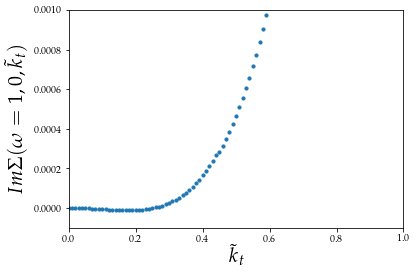

In [191]:
plt.scatter(kr,-posx+posx[0],s=10)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([0,1])
plt.ylim([-0.0001,0.001])

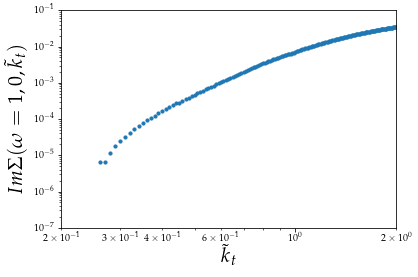

In [192]:
plt.scatter(kr,-posx+posx[0],s=10)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([2*1e-1,2])
plt.ylim([1e-7,1e-1])
plt.xscale('log')
plt.yscale('log')

In [193]:
max(posx)

0.050852266098700874

In [194]:
kr[18]

0.18

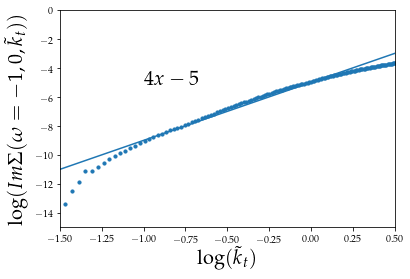

In [195]:
b = 0.05085
logkr = []
logPos = []
for i in range(len(kr)-1):
    if i==17: continue
    logkr.append(math.log(kr[i+1]))
    logPos.append(math.log(abs(b-posx[i+1])))

slopePos, interceptPos, r, p, std_err = stats.linregress(logkr, logPos)
def myfuncPos(x):
    return 4 * x - 5
mymodelPos = list(map(myfuncPos, logkr))    
    
plt.scatter(logkr,logPos,s=10)
plt.plot(logkr,mymodelPos)
plt.xlabel(r'$\log(\tilde{k}_t)$',fontsize=20)
plt.ylabel(r'$\log(Im\Sigma(\omega=1,0,\tilde{k}_t))$',fontsize=20)
plt.xlim([-1.5,0.5])
plt.ylim([-15,0])
plt.text(-1,-5,r'$4x-5$',fontsize=20)
#plt.savefig('Documents/figs/FuncTangPosLog.pdf',bbox_inches="tight")

In [147]:
farr = []
xarr = []
for i in range(len(posx)-2):
    if (posx[i]==0 or posx[i+1]==0):
        continue
        #print(x[i])
    else:
        a = math.log(abs(posx[i+2]))-math.log(abs(posx[i+1]))
        b = math.log(abs(kr[i+2]))-math.log(abs(kr[i+1]))
        if b==0:
            print(kr[i])
        else:
            farr.append(a/b)
            xarr.append(kr[i])

Text(0, 0.5, '$Im\\Sigma(\\omega=1,0,\\tilde{k}_t)$')

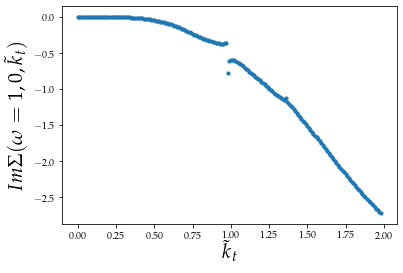

In [148]:
plt.scatter(xarr,farr,s=10)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,0,\tilde{k}_t)$',fontsize=20)
#plt.xlim([2*1e-1,2])
#plt.ylim([1e-7,1e-1])
#plt.xscale('log')
#plt.yscale('log')

In [141]:
slopePos

2.9487388312262017

In [207]:
f = h5py.File("quarticReal/imagTangentialFunc4.h5",'r')
kr = np.array(f['Funcx/args'])
posx = np.array(f['Funcx/Posf'])
negx = np.array(f['Funcx/Negf'])

In [35]:
f = h5py.File("quarticReal/imagTangentialFuncSubtract.h5",'r')
kr = np.array(f['Funcx/args'])
posx = np.array(f['Funcx/Posf'])
negx = np.array(f['Funcx/Negf'])

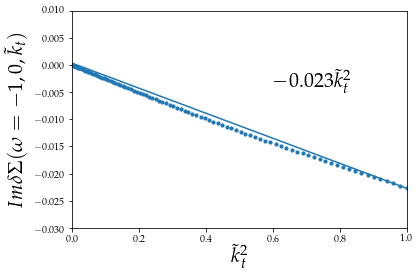

In [44]:
ktquad = kr**2

slopeNeg, interceptNeg, r, p, std_err = stats.linregress(ktquad[0:101], negx[0:101])
def myfuncNeg(x):
    return slopeNeg * x - interceptNeg
mymodelNeg = list(map(myfuncNeg, ktquad)) 

plt.scatter(ktquad,negx,s=10)
plt.plot(ktquad,mymodelNeg)
plt.xlabel(r'$\tilde{k}_t^2$',fontsize=20)
plt.ylabel(r'$Im\delta\Sigma(\omega=-1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([0,1])
plt.ylim([-0.03,0.01])
plt.text(0.6,-0.005,r'$-0.023\tilde{k}_t^2$',fontsize=20)
plt.savefig('Documents/figs/FuncTangNegQuadratic.pdf',bbox_inches="tight")

In [43]:
print(slopeNeg)
print(interceptNeg)

-0.023037645330812175
-0.0003273742394019948


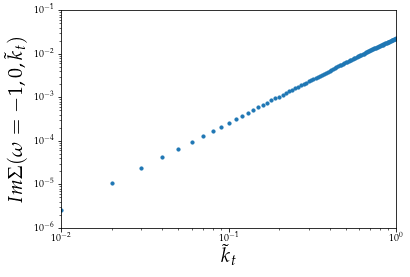

In [186]:
plt.scatter(kr,-negx+negx[0],s=10)
plt.xlabel(r'$\tilde{k}_t$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=-1,0,\tilde{k}_t)$',fontsize=20)
plt.xlim([1e-2,1])
plt.ylim([1e-6,1e-1])
plt.xscale('log')
plt.yscale('log')

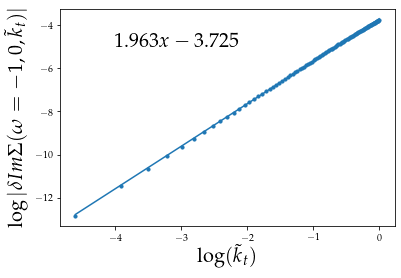

In [187]:
logkr = []
logNeg = []
for i in range(len(kr)-1):
    logkr.append(math.log(kr[i+1]))
    logNeg.append(math.log(negx[0]-negx[i+1]))

slopeNeg, interceptNeg, r, p, std_err = stats.linregress(logkr, logNeg)
def myfuncNeg(x):
    return slopeNeg * x + interceptNeg
mymodelNeg = list(map(myfuncNeg, logkr))    
    
plt.scatter(logkr,logNeg,s=10)
plt.plot(logkr,mymodelNeg)
plt.xlabel(r'$\log(\tilde{k}_t)$',fontsize=20)
plt.ylabel(r'$\log|\delta Im\Sigma(\omega=-1,0,\tilde{k}_t)|$',fontsize=20)
plt.text(-4,-5,r'$1.963x-3.725$',fontsize=20)
plt.savefig('Documents/figs/FuncTangNegLog.pdf',bbox_inches="tight")

In [179]:
slopeNeg

1.9634480526241644

In [180]:
interceptNeg

-3.725243819213552

In [97]:
f = h5py.File("quarticReal/imagRadialFunc.h5",'r')
kr = f['Funcx/args']
posx = f['Funcx/Posf']
negx = f['Funcx/Negf']

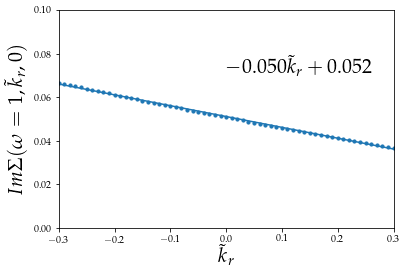

In [108]:
slopePos, interceptPos, r, p, std_err = stats.linregress(kr, posx)
def myfuncPos(x):
    return slopePos * x + interceptPos
mymodelPos = list(map(myfuncPos, kr))


plt.scatter(kr,posx,s=10)
plt.plot(kr,mymodelPos)
plt.xlabel(r'$\tilde{k}_r$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=1,\tilde{k}_r,0)$',fontsize=20)
plt.xlim([-0.3,0.3])
plt.ylim([0.0,0.1])
plt.text(0.0,0.07,r'$-0.050 \tilde{k}_r + 0.052$',fontsize=20)
plt.savefig('Documents/figs/FuncRadPos.pdf',bbox_inches="tight")

In [166]:
(0.05+0.027)/math.pi

0.024509861236151884

In [100]:
print(slopePos)
print(interceptPos)

-0.049849119785713616
0.05117061442635405


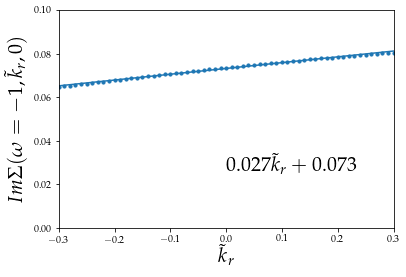

In [107]:
slopeNeg, interceptNeg, r, p, std_err = stats.linregress(kr, negx)
def myfuncNeg(x):
    return slopeNeg * x + interceptNeg
mymodelNeg = list(map(myfuncNeg, kr))

plt.scatter(kr,negx,s=10)
plt.plot(kr,mymodelNeg)
plt.xlabel(r'$\tilde{k}_r$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega=-1,\tilde{k}_r,0)$',fontsize=20)
plt.xlim([-0.3,0.3])
plt.ylim([0.0,0.1])
plt.text(0.0,0.025,r'$0.027 \tilde{k}_r + 0.073$',fontsize=20)
plt.savefig('Documents/figs/FuncRadNeg.pdf',bbox_inches="tight")

In [105]:
print(slopeNeg)
print(interceptNeg)

0.02667102246862151
0.07328319684213894


In [36]:
0.063/math.pi

0.020053522829578813

In [37]:
0.089/math.pi

0.02832957987035737

In [38]:
(0.013+0.025)/math.pi

0.012095775674984046

In [46]:
sel = SelfEnergy(h5py.File('quarticReal/tangentialDependence.h5','r'))
omega = np.array(sel.freqs)
kt = np.array(sel.moms)
SE = sel.SE

In [47]:
np.shape(kt)

(21,)

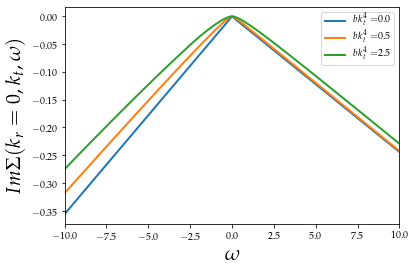

In [48]:
plt.plot(sel.freqs,0.5*np.array(sel.SE[0]),linewidth=2,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[0])**4,1)))
plt.plot(sel.freqs,0.5*np.array(sel.SE[10]),linewidth=2,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[10])**4,1)))
plt.plot(sel.freqs,0.5*np.array(sel.SE[15]),linewidth=2,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[15])**4,1)))
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(k_r=0,k_t,\omega)$',fontsize=20)
plt.xlim([-10,10])
#plt.ylim([1e-5,0.1])
plt.legend()
#plt.savefig('Documents/figs/imagSelfEnergyTangential.pdf',bbox_inches="tight")
plt.show()

In [47]:
sel = SelfEnergy(h5py.File('quarticReal/imagRadial.h5','r'))

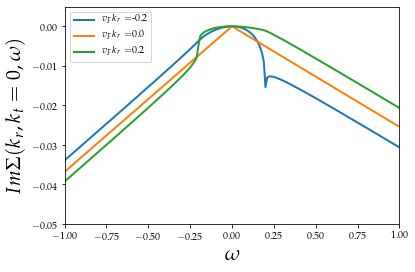

In [49]:
plt.plot(sel.freqs,0.5*np.array(sel.SE[10]),linewidth=2,label= '$v_F k_r = $'+str(round(sel.moms[10],2)))
plt.plot(sel.freqs,0.5*np.array(sel.SE[30]),linewidth=2,label= '$v_F k_r = $'+str(round(sel.moms[30],2)))
plt.plot(sel.freqs,0.5*np.array(sel.SE[50]),linewidth=2,label= '$v_F k_r = $'+str(round(sel.moms[50],2)))
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(k_r,k_t=0,\omega)$',fontsize=20)
plt.xlim([-1,1])
plt.ylim([-0.05,0.005])
plt.legend(loc=2)
plt.savefig('Documents/figs/imagSelfEnergyRadial.pdf',bbox_inches="tight")
plt.show()

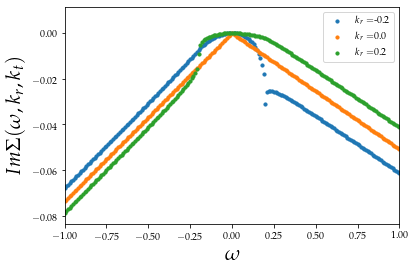

In [15]:
plt.scatter(sel.freqs,sel.SE[10],s=10,label= '$k_r = $'+str(round(sel.moms[10],2)))
#plt.scatter(sel.freqs,sel.SE[25],s=10,label= '$k_r = $'+str(round(sel.moms[25],2)))
plt.scatter(sel.freqs,sel.SE[30],s=10,label= '$k_r = $'+str(round(sel.moms[30],2)))
#plt.scatter(sel.freqs,sel.SE[45],s=10,label= '$k_r = $'+str(round(sel.moms[45],2)))
plt.scatter(sel.freqs,sel.SE[50],s=10,label= '$k_r = $'+str(round(sel.moms[50],2)))
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega,k_r,k_t)$',fontsize=20)
plt.xlim([-1,1])
#plt.ylim([1e-5,0.1])
plt.legend()
#plt.savefig('Documents/figs/imagSelfEnergyRadial.pdf',bbox_inches="tight")
plt.show()

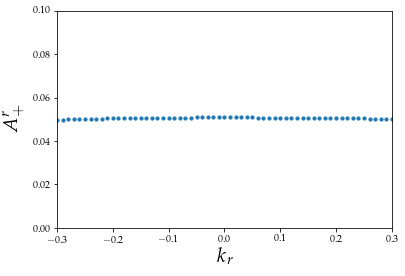

In [45]:
omega = np.array(sel.freqs)
kr = np.array(sel.moms)
SE = sel.SE
#do linear regression for omega>0.5
freqs = omega[125:201]
# write slopes and shifts into lists for each kr value
slopes = []
shiftsPos = []
shiftsNeg = []
for i in range(len(kr)):
    selfe = SE[i][125:201]
    slope, intercept, r, p, std_err = stats.linregress(freqs, selfe)
    slopes.append(slope)
    if i> 30:
        shiftsPos.append(intercept)
    elif i==30:
        shiftsPos.append(intercept)
        #shiftsNeg.append(intercept)
    else:
        shiftsNeg.append(intercept)

krPos = kr[30:61]
krNeg = kr[0:31]
    
plt.scatter(kr,-np.array(slopes),s=10)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$A^r_+$',fontsize=20)
plt.xlim([-0.3,0.3])
plt.ylim([0.0,0.1])
#plt.savefig('Documents/figs/ArPlus.pdf',bbox_inches="tight")
plt.show()

In [46]:
brpos = shiftsNeg+shiftsPos

In [39]:
len(brpos)

61

In [13]:
freqs

array([0.5 , 0.52, 0.54, 0.56, 0.58, 0.6 , 0.62, 0.64, 0.66, 0.68, 0.7 ,
       0.72, 0.74, 0.76, 0.78, 0.8 , 0.82, 0.84, 0.86, 0.88, 0.9 , 0.92,
       0.94, 0.96, 0.98, 1.  , 1.02, 1.04, 1.06, 1.08, 1.1 , 1.12, 1.14,
       1.16, 1.18, 1.2 , 1.22, 1.24, 1.26, 1.28, 1.3 , 1.32, 1.34, 1.36,
       1.38, 1.4 , 1.42, 1.44, 1.46, 1.48, 1.5 , 1.52, 1.54, 1.56, 1.58,
       1.6 , 1.62, 1.64, 1.66, 1.68, 1.7 , 1.72, 1.74, 1.76, 1.78, 1.8 ,
       1.82, 1.84, 1.86, 1.88, 1.9 , 1.92, 1.94, 1.96, 1.98, 2.  ])

In [14]:
sum(slopes)/len(slopes)

-0.05054765599383993

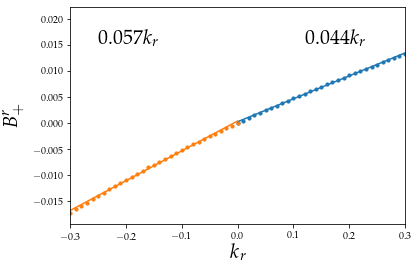

In [15]:
slopePos, interceptPos, r, p, std_err = stats.linregress(krPos, shiftsPos)
def myfuncPos(x):
    return slopePos * x + interceptPos
mymodelPos = list(map(myfuncPos, krPos))

slopeNeg, interceptNeg, r, p, std_err = stats.linregress(krNeg, shiftsNeg)
def myfuncNeg(x):
    return slopeNeg * x + interceptNeg
mymodelNeg = list(map(myfuncNeg, krNeg))

plt.scatter(krPos,shiftsPos,s=10)
plt.plot(krPos,mymodelPos)
plt.scatter(krNeg,shiftsNeg,s=10)
plt.plot(krNeg,mymodelNeg)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$B^r_+$',fontsize=20)
plt.xlim([-0.3,0.3])
#plt.ylim([-0.06,0.0])
plt.text(-0.25,0.015,'$0.057 k_r$',fontsize=20)
plt.text(0.12,0.015,'$0.044 k_r$',fontsize=20)
plt.savefig('Documents/figs/BrPlus.pdf',bbox_inches="tight")
plt.show()

In [97]:
print(slopePos)
print(interceptPos)

0.044065174585077006
0.00026050826127778023


In [98]:
print(slopeNeg)
print(interceptNeg)

0.057304668832439044
0.00039826577408761353


In [119]:
(0.044-0.019)/math.pi

0.007957747154594767

In [120]:
(0.057-0.032)/math.pi

0.007957747154594767

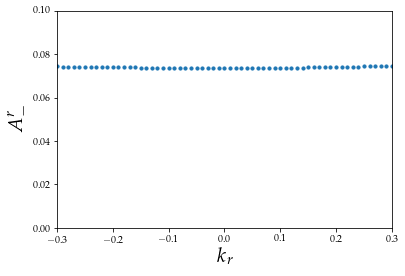

In [47]:
freqs = omega[0:75]
# write slopes and shifts into lists for each kr value
slopes = []
shiftsPos = []
shiftsNeg = []
for i in range(len(kr)):
    selfe = SE[i][0:75]
    slope, intercept, r, p, std_err = stats.linregress(freqs, selfe)
    slopes.append(slope)
    if i> 30:
        shiftsPos.append(intercept)
    elif i==30:
        shiftsPos.append(intercept)
        #shiftsNeg.append(intercept)
    else:
        shiftsNeg.append(intercept)

krPos = kr[30:61]
krNeg = kr[0:31]

plt.scatter(kr,np.array(slopes),s=10)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$A^r_-$',fontsize=20)
plt.xlim([-0.3,0.3])
plt.ylim([0.0,0.1])
#plt.savefig('Documents/figs/ArMinus.pdf',bbox_inches="tight")
plt.show()

In [48]:
brneg = shiftsNeg + shiftsPos

In [43]:
len(brneg)

61

In [113]:
sum(slopes)/len(slopes)

0.073893239833541

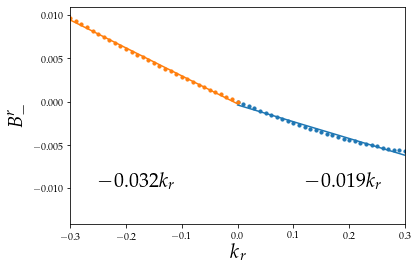

In [110]:
slopePos, interceptPos, r, p, std_err = stats.linregress(krPos, shiftsPos)
def myfuncPos(x):
    return slopePos * x + interceptPos
mymodelPos = list(map(myfuncPos, krPos))

slopeNeg, interceptNeg, r, p, std_err = stats.linregress(krNeg, shiftsNeg)
def myfuncNeg(x):
    return slopeNeg * x + interceptNeg
mymodelNeg = list(map(myfuncNeg, krNeg))

plt.scatter(krPos,shiftsPos,s=10)
plt.plot(krPos,mymodelPos)
plt.scatter(krNeg,shiftsNeg,s=10)
plt.plot(krNeg,mymodelNeg)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$B^r_-$',fontsize=20)
plt.xlim([-0.3,0.3])
#plt.ylim([-0.06,0.0])
plt.text(-0.25,-0.01,'$-0.032 k_r$',fontsize=20)
plt.text(0.12,-0.01,'$-0.019 k_r$',fontsize=20)
#plt.savefig('Documents/figs/BrMinus.pdf',bbox_inches="tight")
plt.show()

In [28]:
shifts = shiftsPos + shiftsNeg

In [29]:
len(shifts)

61

In [30]:
len(kr)

61

In [53]:
br = np.array(brpos)+np.array(brneg)

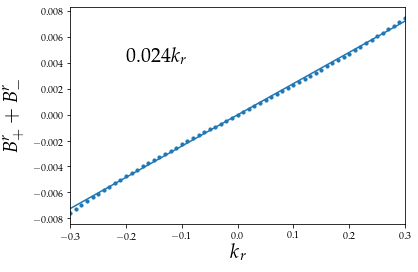

In [61]:
slope, intercept, r, p, std_err = stats.linregress(kr, br)
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, kr))

#plt.scatter(kr,brpos,s=10)
#plt.scatter(kr,brneg,s=10)
plt.plot(kr,mymodel)
plt.scatter(kr,br,s=10)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$B^r_+ + B^r_-$',fontsize=20)
plt.xlim([-0.3,0.3])
#plt.ylim([-0.06,0.0])
plt.text(-0.2,0.004,'$0.024 k_r$',fontsize=20)
plt.savefig('Documents/figs/Br.pdf',bbox_inches="tight")
plt.show()

In [56]:
print(slope)
print(intercept)

0.024138085744483236
-1.7414771289145656e-05


In [59]:
slope/3.14

0.007687288453657081

In [108]:
print(slopeNeg)
print(interceptNeg)

-0.032360868051495864
-0.00025935972243873104


In [78]:
print(slope)
print(intercept)

-0.026208087981955525
0.0006570135294034481


In [28]:
fullRadialData = SelfEnergy(h5py.File('quarticReal/imagRadial.h5','r'))
sel = SelfEnergy(h5py.File('quarticReal/imagRadial.h5','r'))

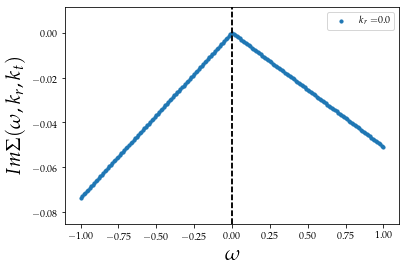

In [29]:
fullRadialData.plotSelfEnergykr(30)

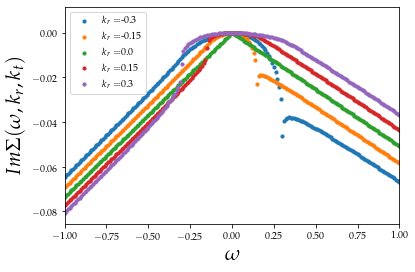

In [30]:
plt.scatter(sel.freqs,sel.SE[0],s=10,label= '$k_r = $'+str(round(sel.moms[0],2)))
plt.scatter(sel.freqs,sel.SE[15],s=10,label= '$k_r = $'+str(round(sel.moms[15],2)))
plt.scatter(sel.freqs,sel.SE[30],s=10,label= '$k_r = $'+str(round(sel.moms[30],2)))
plt.scatter(sel.freqs,sel.SE[45],s=10,label= '$k_r = $'+str(round(sel.moms[45],2)))
plt.scatter(sel.freqs,sel.SE[60],s=10,label= '$k_r = $'+str(round(sel.moms[60],2)))
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega,k_r,k_t)$',fontsize=20)
plt.xlim([-1,1])
#plt.ylim([1e-5,0.1])
plt.legend()
plt.savefig('Documents/figs/imagSelfEnergyRadial.pdf',bbox_inches="tight")
plt.show()

In [31]:
omega = np.array(fullRadialData.freqs)
kr = np.array(fullRadialData.moms)
SE = fullRadialData.SE

In [32]:
#do linear regression for omega>0.5
freqs = omega[150:201]
# write slopes and shifts into lists for each kr value
slopes = []
shifts = []
for i in range(len(kr)):
    selfe = SE[i][150:201]
    slope, intercept, r, p, std_err = stats.linregress(freqs, selfe)
    slopes.append(slope)
    shifts.append(intercept)

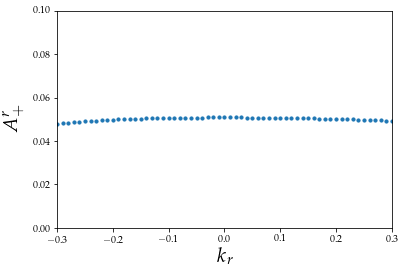

In [33]:
plt.scatter(kr,-np.array(slopes),s=10)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$A^r_+$',fontsize=20)
plt.xlim([-0.3,0.3])
plt.ylim([0.0,0.1])
plt.savefig('Documents/figs/ArPlus.pdf',bbox_inches="tight")
plt.show()

In [34]:
slope, intercept, r, p, std_err = stats.linregress(kr, shifts)
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, kr))

In [35]:
slope

0.05103926047082765

In [36]:
intercept

-0.000996910560209099

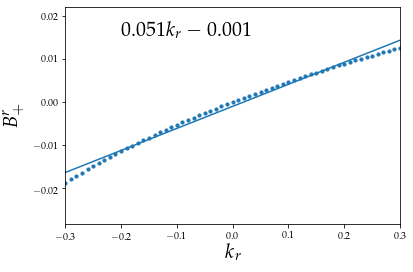

In [37]:
plt.scatter(kr,shifts,s=10)
plt.plot(kr,mymodel)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$B^r_+$',fontsize=20)
plt.xlim([-0.3,0.3])
#plt.ylim([-0.06,0.0])
plt.text(-0.2,0.015,'$0.051 k_r - 0.001$',fontsize=20)
plt.savefig('Documents/figs/BrPlus.pdf',bbox_inches="tight")
plt.show()

In [38]:
#do linear regression for omega<-0.5
freqs = omega[0:25]
# write slopes and shifts into lists for each kr value
slopes = []
shifts = []
for i in range(len(kr)):
    selfe = SE[i][0:25]
    slope, intercept, r, p, std_err = stats.linregress(freqs, selfe)
    slopes.append(slope)
    shifts.append(intercept)

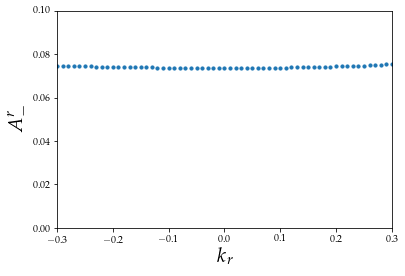

In [39]:
plt.scatter(kr,slopes,s=10)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$A^r_-$',fontsize=20)
plt.xlim([-0.3,0.3])
plt.ylim([0.0,0.1])
plt.savefig('Documents/figs/ArMinus.pdf',bbox_inches="tight")
plt.show()

In [40]:
sum(slopes)/len(slopes)

0.07406993609906701

In [41]:
slope, intercept, r, p, std_err = stats.linregress(kr[20:40], shifts[20:40])
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, kr))

In [42]:
kr[40]

0.10000000000000003

In [43]:
slope

-0.027013487704881167

In [44]:
intercept

7.752583605221425e-05

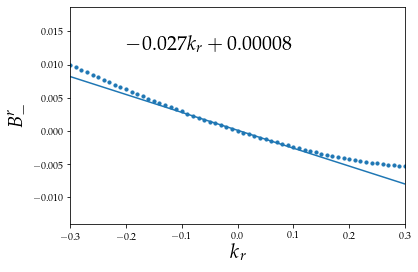

In [45]:
plt.scatter(kr,shifts,s=10)
plt.plot(kr,mymodel)
plt.xlabel(r'$k_r$',fontsize=20)
plt.ylabel(r'$B^r_-$',fontsize=20)
plt.xlim([-0.3,0.3])
#plt.ylim([-0.06,0.0])
plt.text(-0.2,0.012,'$-0.027 k_r + 0.00008$',fontsize=20)
plt.savefig('Documents/figs/BrMinus.pdf',bbox_inches="tight")
plt.show()

In [46]:
slope

-0.027013487704881167

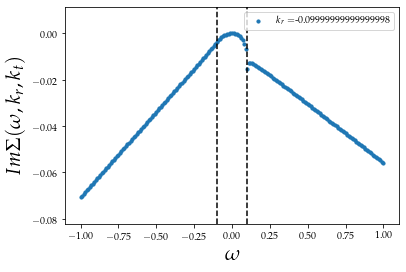

In [47]:
fullRadialData.plotSelfEnergykr(20)

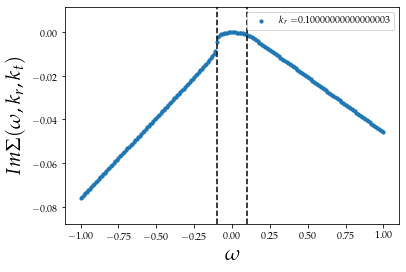

In [48]:
fullRadialData.plotSelfEnergykr(40)

In [6]:
sel = SelfEnergy(h5py.File('quarticReal/imagTangentialQuartic10.h5','r'))

In [7]:
omega = np.array(sel.freqs)
kt = np.array(sel.moms)
SE = sel.SE

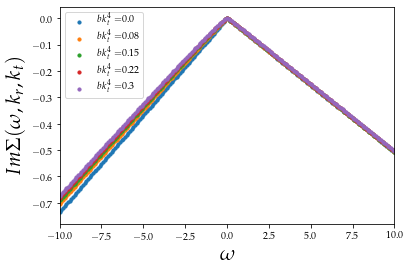

In [9]:
plt.scatter(sel.freqs,sel.SE[0],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[0])**4,2)))
plt.scatter(sel.freqs,sel.SE[15],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[15])**4,2)))
plt.scatter(sel.freqs,sel.SE[30],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[30])**4,2)))
plt.scatter(sel.freqs,sel.SE[45],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[45])**4,2)))
plt.scatter(sel.freqs,sel.SE[60],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[60])**4,2)))
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega,k_r,k_t)$',fontsize=20)
plt.xlim([-10,10])
#plt.ylim([1e-5,0.1])
plt.legend()
plt.savefig('Documents/figs/imagSelfEnergyTangential.pdf',bbox_inches="tight")
plt.show()

In [10]:
omega[110]

1.0

In [11]:
#do linear regression for omega>1
freqs = omega[110:201]
# write slopes and shifts into lists for each kr value
slopes = []
shifts = []
for i in range(len(kt)):
    selfe = SE[i][110:201]
    slope, intercept, r, p, std_err = stats.linregress(freqs, selfe)
    slopes.append(slope)
    shifts.append(intercept)

In [12]:
ktquart = [x**4 for x in kt]

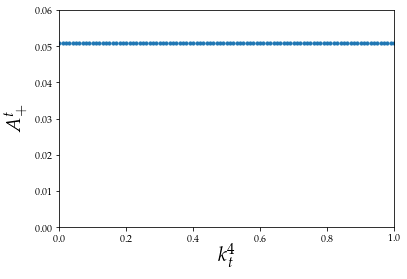

In [13]:
plt.scatter(ktquart,-np.array(slopes),s=10)
plt.xlabel(r'$k_t^4$',fontsize=20)
plt.ylabel(r'$A^t_+$',fontsize=20)
plt.xlim([0.0,1])
plt.ylim([0.0,0.06])
plt.savefig('Documents/figs/AtPlus.pdf',bbox_inches="tight")
plt.show()

In [14]:
slope, intercept, r, p, std_err = stats.linregress(ktquart, shifts)
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, kt))

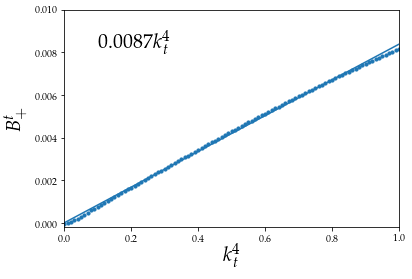

In [15]:
plt.scatter(ktquart,shifts,s=10)
#plt.scatter(ktquad,shifts,s=10)
plt.plot(kt,mymodel)
plt.xlabel(r'$k_t^4$',fontsize=20)
plt.ylabel(r'$B^t_+$',fontsize=20)
plt.xlim([0.0,1])
plt.ylim([-0.0002,0.01])
plt.text(0.1,0.008,'$0.0087 k_t^4$',fontsize=20)
plt.savefig('Documents/figs/BtPlus.pdf',bbox_inches="tight")
plt.show()

In [16]:
omega[91]

-0.9000000000000004

In [17]:
#do linear regression for omega<-0.5
freqs = omega[0:91]
# write slopes and shifts into lists for each kr value
slopes = []
shifts = []
for i in range(len(kt)):
    selfe = SE[i][0:91]
    slope, intercept, r, p, std_err = stats.linregress(freqs, selfe)
    slopes.append(slope)
    shifts.append(intercept)

In [26]:
ktquad = [x**2 for x in kt]
slope, intercept, r, p, std_err = stats.linregress(ktquad, np.array(slopes))
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, ktquad))

In [27]:
print(slope)
print(intercept)

-0.00602932600587712
0.07362071703182962


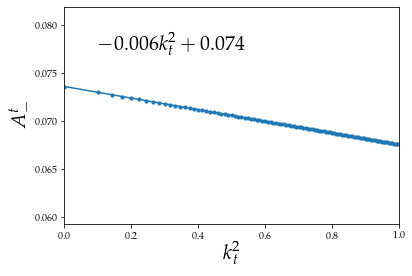

In [21]:
plt.scatter(ktquad,np.array(slopes),s=10)
plt.plot(ktquad,mymodel)
plt.xlabel(r'$k_t^2$',fontsize=20)
plt.ylabel(r'$A^t_-$',fontsize=20)
plt.xlim([0.0,1])
#plt.ylim([0.0,0.08])
plt.text(0.1,0.077,'$-0.006 k_t^2+0.074$',fontsize=20)
plt.savefig('Documents/figs/AtMinus.pdf',bbox_inches="tight")
plt.show()

In [22]:
slope, intercept, r, p, std_err = stats.linregress(ktquad, shifts)
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, ktquad))

In [23]:
print(slope)
print(intercept)

0.022117645682175766
0.001113153992172199


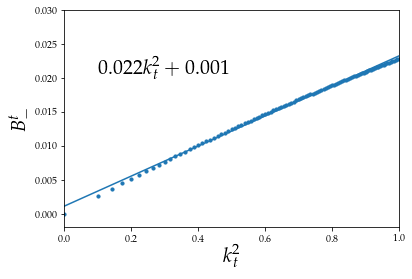

In [25]:
plt.scatter(ktquad,shifts,s=10)
plt.plot(ktquad,mymodel)
plt.xlabel(r'$k_t^2$',fontsize=20)
plt.ylabel(r'$B^t_-$',fontsize=20)
plt.xlim([0.0,1])
plt.ylim([-0.002,0.03])
plt.text(0.1, 0.02,'$0.022 k_t^2 + 0.001$',fontsize=20)
plt.savefig('Documents/figs/BtMinus.pdf',bbox_inches="tight")
plt.show()

In [238]:
fullTangentialData = SelfEnergy(h5py.File('quarticReal/imagTangentialQuartic.h5','r'))
sel = SelfEnergy(h5py.File('quarticReal/imagTangentialQuartic.h5','r'))

In [239]:
omega = np.array(fullTangentialData.freqs)
kt = np.array(fullTangentialData.moms)
SE = fullTangentialData.SE

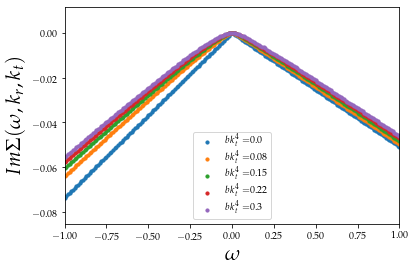

In [240]:
plt.scatter(sel.freqs,sel.SE[0],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[0])**4,2)))
plt.scatter(sel.freqs,sel.SE[15],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[15])**4,2)))
plt.scatter(sel.freqs,sel.SE[30],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[30])**4,2)))
plt.scatter(sel.freqs,sel.SE[45],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[45])**4,2)))
plt.scatter(sel.freqs,sel.SE[60],s=10,label= '$bk_t^4 = $'+str(round(0.5*(sel.moms[60])**4,2)))
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega,k_r,k_t)$',fontsize=20)
plt.xlim([-1,1])
#plt.ylim([1e-5,0.1])
plt.legend()
plt.savefig('Documents/figs/imagSelfEnergyTangential.pdf',bbox_inches="tight")
plt.show()

In [242]:
#do linear regression for omega>0.5
freqs = omega[150:201]
# write slopes and shifts into lists for each kr value
slopes = []
shifts = []
for i in range(len(kt)):
    selfe = SE[i][150:201]
    slope, intercept, r, p, std_err = stats.linregress(freqs, selfe)
    slopes.append(slope)
    shifts.append(intercept)

In [243]:
ktquart = [x**4 for x in kt]

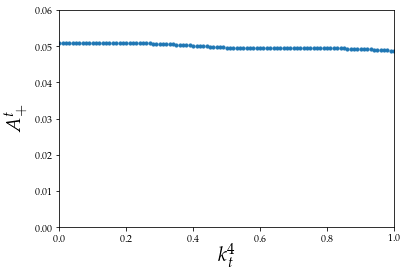

In [245]:
plt.scatter(ktquart,-np.array(slopes),s=10)
plt.xlabel(r'$k_t^4$',fontsize=20)
plt.ylabel(r'$A^t_+$',fontsize=20)
plt.xlim([0.0,1])
plt.ylim([0.0,0.06])
plt.savefig('Documents/figs/AtPlus.pdf',bbox_inches="tight")
plt.show()

In [246]:
slope, intercept, r, p, std_err = stats.linregress(ktquart[0:20], shifts[0:20])
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, kt))

In [247]:
kt[20]

0.668740304976422

In [248]:
slope

0.00865023326753509

In [249]:
intercept

-4.2807986043403787e-07

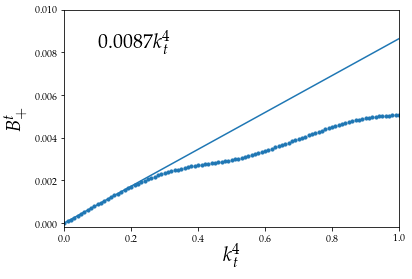

In [250]:
plt.scatter(ktquart,shifts,s=10)
#plt.scatter(ktquad,shifts,s=10)
plt.plot(kt,mymodel)
plt.xlabel(r'$k_t^4$',fontsize=20)
plt.ylabel(r'$B^t_+$',fontsize=20)
plt.xlim([0.0,1])
plt.ylim([-0.0002,0.01])
plt.text(0.1,0.008,'$0.0087 k_t^4$',fontsize=20)
plt.savefig('Documents/figs/BtPlus.pdf',bbox_inches="tight")
plt.show()

In [251]:
#do linear regression for omega<-0.5
freqs = omega[0:51]
# write slopes and shifts into lists for each kr value
slopes = []
shifts = []
for i in range(len(kt)):
    selfe = SE[i][0:51]
    slope, intercept, r, p, std_err = stats.linregress(freqs, selfe)
    slopes.append(slope)
    shifts.append(intercept)

In [252]:
ktquad = [x**2 for x in kt]

In [261]:
slope, intercept, r, p, std_err = stats.linregress(ktquad, np.array(slopes))
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, ktquad))

In [262]:
slope

-0.014467588996096188

In [263]:
intercept

0.07323953643919252

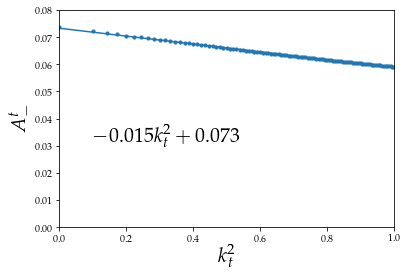

In [264]:
plt.scatter(ktquad,np.array(slopes),s=10)
plt.plot(ktquad,mymodel)
plt.xlabel(r'$k_t^2$',fontsize=20)
plt.ylabel(r'$A^t_-$',fontsize=20)
plt.xlim([0.0,1])
plt.ylim([0.0,0.08])
plt.text(0.1,0.03,'$-0.015 k_t^2+0.073$',fontsize=20)
plt.savefig('Documents/figs/AtMinus.pdf',bbox_inches="tight")
plt.show()

In [202]:
slope, intercept, r, p, std_err = stats.linregress(ktquad[0:20], shifts[0:20])
def myfunc(x):
    return slope * x + intercept
mymodel = list(map(myfunc, kt))

In [203]:
slope

0.009291440642329387

In [204]:
intercept

0.00017834505100910265

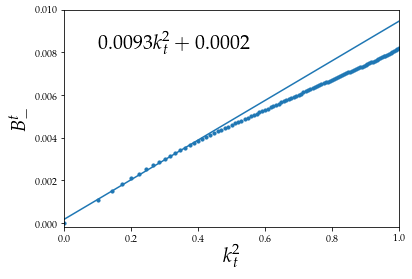

In [211]:
plt.scatter(ktquad,shifts,s=10)
plt.plot(kt,mymodel)
plt.xlabel(r'$k_t^2$',fontsize=20)
plt.ylabel(r'$B^t_-$',fontsize=20)
plt.xlim([0.0,1])
plt.ylim([-0.0002,0.01])
plt.text(0.1, 0.008,'$0.0093 k_t^2 + 0.0002$',fontsize=20)
plt.savefig('Documents/figs/BtMinus.pdf',bbox_inches="tight")
plt.show()

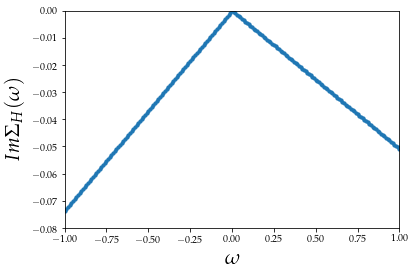

In [25]:
fullTangentialData.positiveSelfEnergy(0)

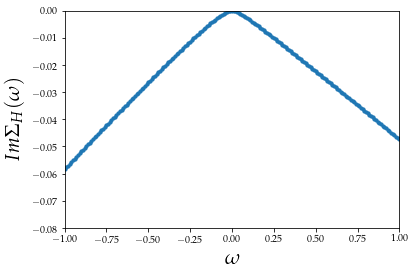

In [26]:
fullTangentialData.positiveSelfEnergy(80)

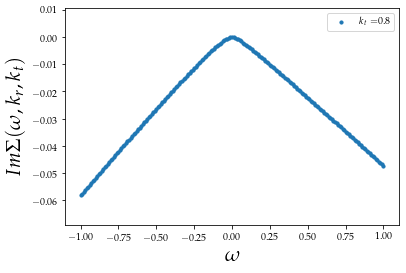

In [27]:
fullTangentialData.plotSelfEnergykt(80)

In [17]:
omega = Bubble(h5py.File('quarticReal/imagKt15.h5','r')).freqs
SE15 = Bubble(h5py.File('quarticReal/imagKt15.h5','r')).SEPos
SE1 = Bubble(h5py.File('quarticReal/imagKt1.h5','r')).SEPos
SE125 = Bubble(h5py.File('quarticReal/imagKt125.h5','r')).SEPos
SE2 = Bubble(h5py.File('quarticReal/imagKt2.h5','r')).SEPos

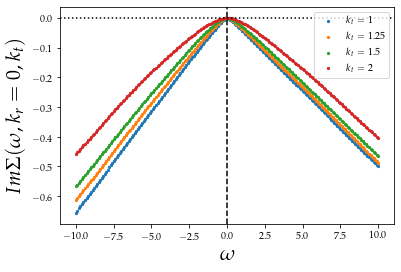

In [19]:
plt.scatter(omega,SE1,s=5,label='$k_t=1$')
plt.scatter(omega,SE125,s=5,label='$k_t=1.25$')
plt.scatter(omega,SE15,s=5,label='$k_t=1.5$')
plt.scatter(omega,SE2,s=5,label='$k_t=2$')
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega,k_r=0,k_t)$',fontsize=20)
plt.axvline(0,linestyle = 'dashed',color = 'black')
plt.axhline(0,linestyle = 'dotted',color = 'black')
#plt.xlim([-1,1])
#plt.ylim([-0.1,0.01])
plt.legend(loc='upper right')
#plt.savefig('Documents/figs/quarticImagSelfEnergyOmegavariouskr.pdf',bbox_inches="tight")
plt.show()

In [20]:
2**4

16

In [21]:
omega = Bubble(h5py.File('quarticReal/imag100Kt15.h5','r')).freqs
SE15 = Bubble(h5py.File('quarticReal/imag100Kt15.h5','r')).SEPos
SE1 = Bubble(h5py.File('quarticReal/imag100Kt1.h5','r')).SEPos
SE125 = Bubble(h5py.File('quarticReal/imag100Kt125.h5','r')).SEPos
SE2 = Bubble(h5py.File('quarticReal/imag100Kt2.h5','r')).SEPos

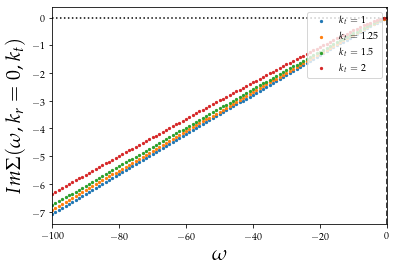

In [24]:
plt.scatter(omega,SE1,s=5,label='$k_t=1$')
plt.scatter(omega,SE125,s=5,label='$k_t=1.25$')
plt.scatter(omega,SE15,s=5,label='$k_t=1.5$')
plt.scatter(omega,SE2,s=5,label='$k_t=2$')
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega,k_r=0,k_t)$',fontsize=20)
plt.axvline(0,linestyle = 'dashed',color = 'black')
plt.axhline(0,linestyle = 'dotted',color = 'black')
plt.xlim([-100,-0])
#plt.ylim([-0.1,0.01])
plt.legend(loc='upper right')
#plt.savefig('Documents/figs/quarticImagSelfEnergyOmegavariouskr.pdf',bbox_inches="tight")
plt.show()

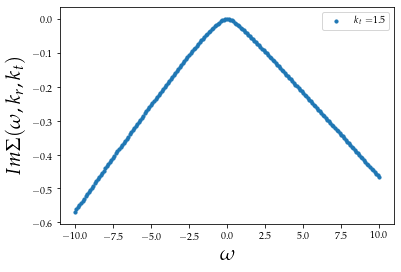

In [15]:
Bubble(h5py.File('quarticReal/imagKt15.h5','r')).plotSelfEnergykt()

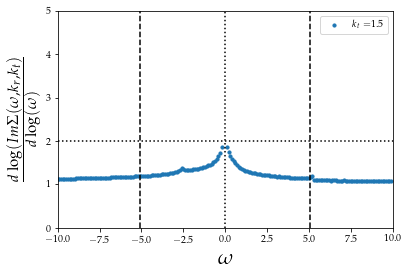

In [16]:
Bubble(h5py.File('quarticReal/imagKt15.h5','r')).logDPlotkt()

In [ ]:
Bubble(h5py.File('quarticReal/imagKt15.h5','r')).plotSelfEnergy()

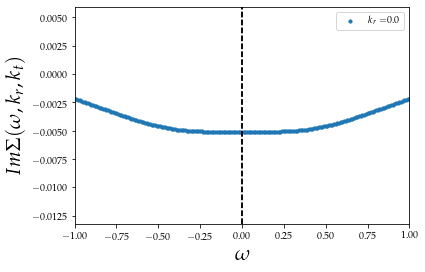

In [230]:
Bubble(h5py.File('quarticReal/imagKtDependence01.h5','r')).plotSelfEnergy()

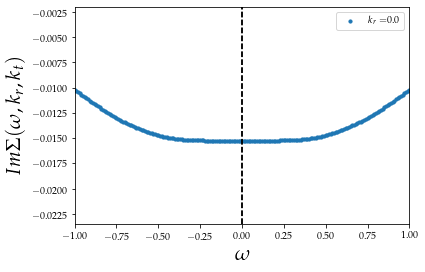

In [229]:
Bubble(h5py.File('quarticReal/imagKtDependence03.h5','r')).plotSelfEnergy()

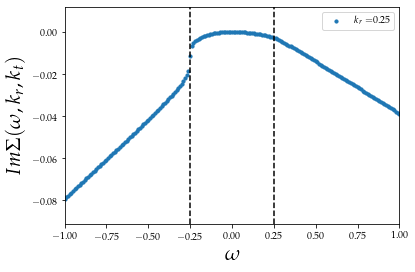

In [212]:
Bubble(h5py.File('quarticReal/frequencyDependence025.h5','r')).plotSelfEnergy()

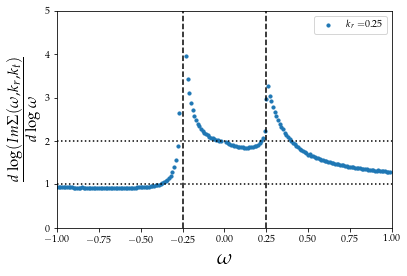

In [213]:
Bubble(h5py.File('quarticReal/frequencyDependence025.h5','r')).logDPlotkr()

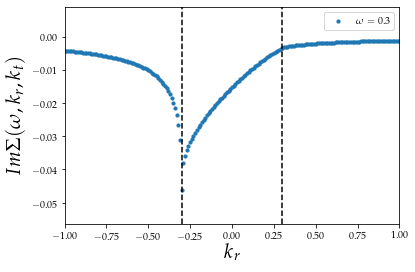

In [163]:
Bubble(h5py.File('quarticReal/imagKrDependence03.h5','r')).plotSelfEnergy()

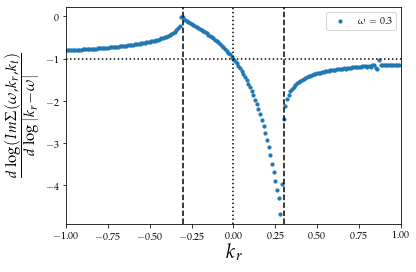

In [164]:
Bubble(h5py.File('quarticReal/imagKrDependence03.h5','r')).logDPlotkr()

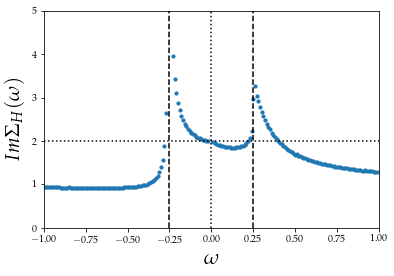

In [85]:
Bubble(h5py.File('quarticReal/frequencyDependence025.h5','r')).logDPlot()

In [191]:
se0 = Bubble(h5py.File('quarticReal/frequencyDependence0.h5','r')).SEPos
se01 = Bubble(h5py.File('quarticReal/frequencyDependence2.h5','r')).SEPos
se025 = Bubble(h5py.File('quarticReal/frequencyDependence025.h5','r')).SEPos
se05 = Bubble(h5py.File('quarticReal/frequencyDependence3.h5','r')).SEPos
omega = Bubble(h5py.File('quarticReal/frequencyDependence0.h5','r')).freqs

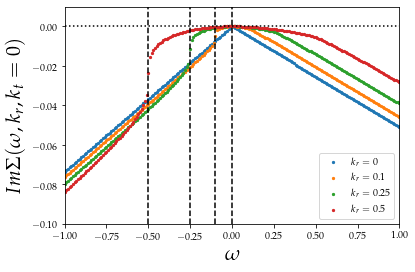

In [193]:
plt.scatter(omega,se0,s=5,label='$k_r=0$')
plt.scatter(omega,se01,s=5,label='$k_r=0.1$')
plt.scatter(omega,se025,s=5,label='$k_r=0.25$')
plt.scatter(omega,se05,s=5,label='$k_r=0.5$')
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega,k_r,k_t=0)$',fontsize=20)
plt.axvline(-0.1,linestyle = 'dashed',color = 'black')
plt.axvline(-0.25,linestyle = 'dashed',color = 'black')
plt.axvline(-0.5,linestyle = 'dashed',color = 'black')
plt.axvline(0,linestyle = 'dashed',color = 'black')
plt.axhline(0,linestyle = 'dotted',color = 'black')
plt.xlim([-1,1])
plt.ylim([-0.1,0.01])
plt.legend(loc='lower right')
plt.savefig('Documents/figs/quarticImagSelfEnergyOmegavariouskr.pdf',bbox_inches="tight")
plt.show()

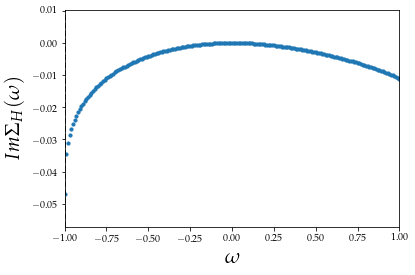

In [52]:
Bubble(h5py.File('quarticReal/frequencyDependence100.h5','r')).plotSelfEnergy()

In [166]:
Bubble(h5py.File('quarticReal/frequencyDependence025.h5','r')).plotSelfEnergy()

RuntimeError: latex was not able to process the following string:
b'$\\\\k_r=$0.25'

Here is the full report generated by latex:
This is pdfTeX, Version 3.14159265-2.6-1.40.18 (TeX Live 2017/TeX Live for SUSE Linux) (preloaded format=latex)
 restricted \write18 enabled.
entering extended mode

(/home/debbeler/.cache/matplotlib/tex.cache/5a6d98ba422ab29efb1bfcfda68e63f6.te
x
LaTeX2e <2017-04-15>
Babel <3.10> and hyphenation patterns for 12 language(s) loaded.
(/usr/share/texmf/tex/latex/base/article.cls
Document Class: article 2014/09/29 v1.4h Standard LaTeX document class
(/usr/share/texmf/tex/latex/base/size10.clo))
(/usr/share/texmf/tex/latex/type1cm/type1cm.sty)
(/usr/share/texmf/tex/latex/psnfss/mathpazo.sty)
(/usr/share/texmf/tex/latex/psnfss/helvet.sty
(/usr/share/texmf/tex/latex/graphics/keyval.sty))
(/usr/share/texmf/tex/latex/base/textcomp.sty
(/usr/share/texmf/tex/latex/base/ts1enc.def))
(/usr/share/texmf/tex/latex/base/inputenc.sty
(/usr/share/texmf/tex/latex/base/utf8.def
(/usr/share/texmf/tex/latex/base/t1enc.dfu)
(/usr/share/texmf/tex/latex/base/ot1enc.dfu)
(/usr/share/texmf/tex/latex/base/omsenc.dfu)
(/usr/share/texmf/tex/latex/base/ts1enc.dfu)))
(/usr/share/texmf/tex/latex/amsmath/amsmath.sty
For additional information on amsmath, use the `?' option.
(/usr/share/texmf/tex/latex/amsmath/amstext.sty
(/usr/share/texmf/tex/latex/amsmath/amsgen.sty))
(/usr/share/texmf/tex/latex/amsmath/amsbsy.sty)
(/usr/share/texmf/tex/latex/amsmath/amsopn.sty))
(/usr/share/texmf/tex/latex/geometry/geometry.sty
(/usr/share/texmf/tex/generic/oberdiek/ifpdf.sty)
(/usr/share/texmf/tex/generic/oberdiek/ifvtex.sty)
(/usr/share/texmf/tex/generic/ifxetex/ifxetex.sty)
(/usr/local/server/teTeX/local/tex/latex/contrib/supported/geometry/geometry.cf
g)

Package geometry Warning: Over-specification in `h'-direction.
    `width' (5058.9pt) is ignored.


Package geometry Warning: Over-specification in `v'-direction.
    `height' (5058.9pt) is ignored.

)
No file 5a6d98ba422ab29efb1bfcfda68e63f6.aux.
(/usr/share/texmf/tex/latex/base/ts1cmr.fd)
(/usr/share/texmf/tex/latex/psnfss/ot1ppl.fd)
*geometry* detected driver: dvips
(/usr/share/texmf/tex/latex/psnfss/omlzplm.fd)
(/usr/share/texmf/tex/latex/psnfss/omszplm.fd)
(/usr/share/texmf/tex/latex/psnfss/omxzplm.fd)
(/usr/share/texmf/tex/latex/psnfss/ot1zplm.fd)

LaTeX Warning: Command \k invalid in math mode on input line 14.


! LaTeX Error: Command \k unavailable in encoding OT1.

See the LaTeX manual or LaTeX Companion for explanation.
Type  H <return>  for immediate help.
 ...                                              
                                                  
l.14 \fontsize{10.000000}{12.500000}{\rmfamily $\k
                                                  _r=$0.25}
No pages of output.
Transcript written on 5a6d98ba422ab29efb1bfcfda68e63f6.log.




RuntimeError: latex was not able to process the following string:
b'$\\\\k_r=$0.25'

Here is the full report generated by latex:
This is pdfTeX, Version 3.14159265-2.6-1.40.18 (TeX Live 2017/TeX Live for SUSE Linux) (preloaded format=latex)
 restricted \write18 enabled.
entering extended mode

(/home/debbeler/.cache/matplotlib/tex.cache/5a6d98ba422ab29efb1bfcfda68e63f6.te
x
LaTeX2e <2017-04-15>
Babel <3.10> and hyphenation patterns for 12 language(s) loaded.
(/usr/share/texmf/tex/latex/base/article.cls
Document Class: article 2014/09/29 v1.4h Standard LaTeX document class
(/usr/share/texmf/tex/latex/base/size10.clo))
(/usr/share/texmf/tex/latex/type1cm/type1cm.sty)
(/usr/share/texmf/tex/latex/psnfss/mathpazo.sty)
(/usr/share/texmf/tex/latex/psnfss/helvet.sty
(/usr/share/texmf/tex/latex/graphics/keyval.sty))
(/usr/share/texmf/tex/latex/base/textcomp.sty
(/usr/share/texmf/tex/latex/base/ts1enc.def))
(/usr/share/texmf/tex/latex/base/inputenc.sty
(/usr/share/texmf/tex/latex/base/utf8.def
(/usr/share/texmf/tex/latex/base/t1enc.dfu)
(/usr/share/texmf/tex/latex/base/ot1enc.dfu)
(/usr/share/texmf/tex/latex/base/omsenc.dfu)
(/usr/share/texmf/tex/latex/base/ts1enc.dfu)))
(/usr/share/texmf/tex/latex/amsmath/amsmath.sty
For additional information on amsmath, use the `?' option.
(/usr/share/texmf/tex/latex/amsmath/amstext.sty
(/usr/share/texmf/tex/latex/amsmath/amsgen.sty))
(/usr/share/texmf/tex/latex/amsmath/amsbsy.sty)
(/usr/share/texmf/tex/latex/amsmath/amsopn.sty))
(/usr/share/texmf/tex/latex/geometry/geometry.sty
(/usr/share/texmf/tex/generic/oberdiek/ifpdf.sty)
(/usr/share/texmf/tex/generic/oberdiek/ifvtex.sty)
(/usr/share/texmf/tex/generic/ifxetex/ifxetex.sty)
(/usr/local/server/teTeX/local/tex/latex/contrib/supported/geometry/geometry.cf
g)

Package geometry Warning: Over-specification in `h'-direction.
    `width' (5058.9pt) is ignored.


Package geometry Warning: Over-specification in `v'-direction.
    `height' (5058.9pt) is ignored.

) (./5a6d98ba422ab29efb1bfcfda68e63f6.aux)
(/usr/share/texmf/tex/latex/base/ts1cmr.fd)
(/usr/share/texmf/tex/latex/psnfss/ot1ppl.fd)
*geometry* detected driver: dvips
(/usr/share/texmf/tex/latex/psnfss/omlzplm.fd)
(/usr/share/texmf/tex/latex/psnfss/omszplm.fd)
(/usr/share/texmf/tex/latex/psnfss/omxzplm.fd)
(/usr/share/texmf/tex/latex/psnfss/ot1zplm.fd)

LaTeX Warning: Command \k invalid in math mode on input line 14.


! LaTeX Error: Command \k unavailable in encoding OT1.

See the LaTeX manual or LaTeX Companion for explanation.
Type  H <return>  for immediate help.
 ...                                              
                                                  
l.14 \fontsize{10.000000}{12.500000}{\rmfamily $\k
                                                  _r=$0.25}
No pages of output.
Transcript written on 5a6d98ba422ab29efb1bfcfda68e63f6.log.




<Figure size 432x288 with 1 Axes>

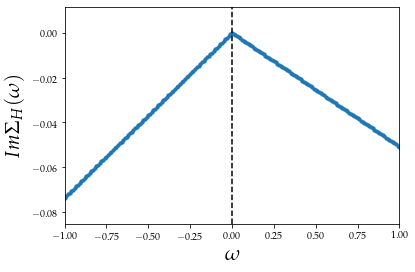

In [39]:
Bubble(h5py.File('quarticReal/frequencyDependence0.h5','r')).plotSelfEnergy()

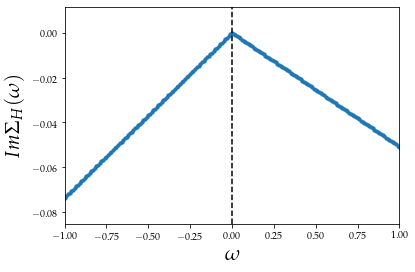

In [40]:
foo0=Bubble(h5py.File('quarticReal/frequencyDependence0.h5','r'))
foo0.plotSelfEnergy()

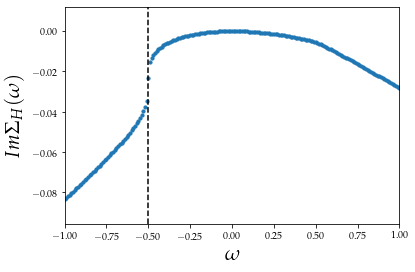

In [41]:
foo3=Bubble(h5py.File('quarticReal/frequencyDependence3.h5','r'))
foo3.plotSelfEnergy()

In [42]:
foo=Bubble(h5py.File('quarticReal/frequencyDependence2.h5','r'))

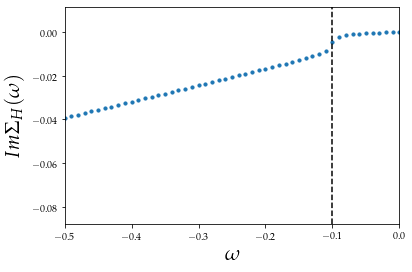

In [30]:
foo.plotSelfEnergy()

In [5]:
foo=Bubble(h5py.File('quarticReal/frequencyDependence1.h5','r'))

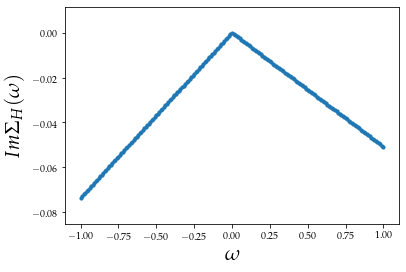

In [7]:
foo.plotSelfEnergy()

In [15]:
foo1=Bubble(h5py.File('quarticReal/frequencyDependenceFirstTerm1.h5','r'))

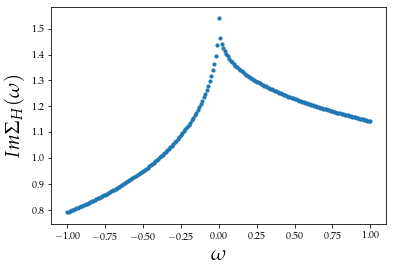

In [16]:
foo1.plotSelfEnergy()

In [17]:
foo3=Bubble(h5py.File('quarticReal/frequencyDependenceFirstTerm3.h5','r'))

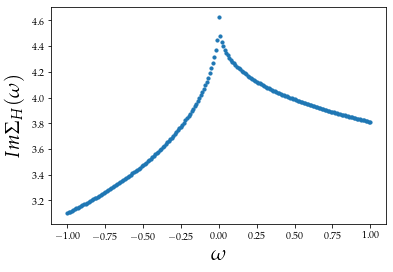

In [18]:
foo3.plotSelfEnergy()

In [19]:
bar1 = Bubble(h5py.File('quarticReal/frequencyDependenceSecondTerm1.h5','r'))

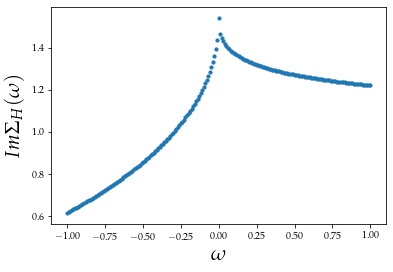

In [20]:
bar1.plotSelfEnergy()

In [21]:
bar3 = Bubble(h5py.File('quarticReal/frequencyDependenceSecondTerm3.h5','r'))

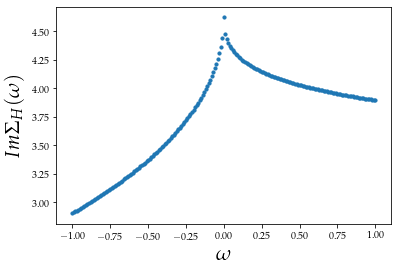

In [22]:
bar3.plotSelfEnergy()

In [23]:
reg1 = Bubble(h5py.File('quarticReal/frequencyDependenceFirstRegularized1.h5','r'))

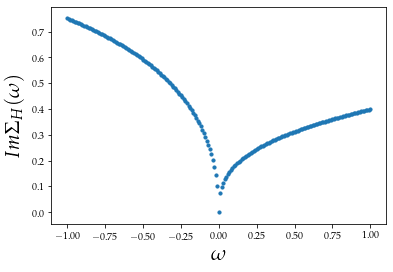

In [24]:
reg1.plotSelfEnergy()

In [25]:
reg3 = Bubble(h5py.File('quarticReal/frequencyDependenceFirstRegularized3.h5','r'))

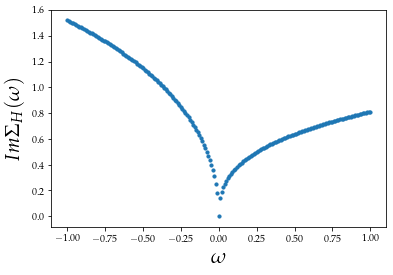

In [26]:
reg3.plotSelfEnergy()

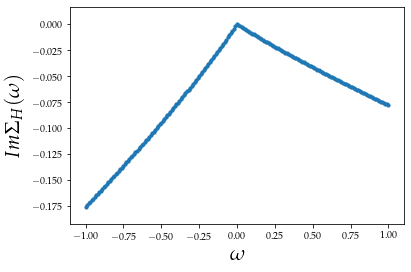

In [12]:
both = Bubble(h5py.File('quarticReal/frequencyDependenceBoth.h5','r'))
both.plotSelfEnergy()

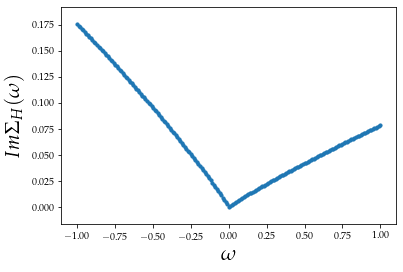

In [7]:
both = Bubble(h5py.File('quarticReal/frequencyDependenceBothTerms.h5','r'))
both.plotSelfEnergy()

In [10]:
both = Bubble(h5py.File('quarticReal/frequencyDependenceBoth100.h5','r'))
both.plotSelfEnergy()

TypeError: bad operand type for unary -: 'list'

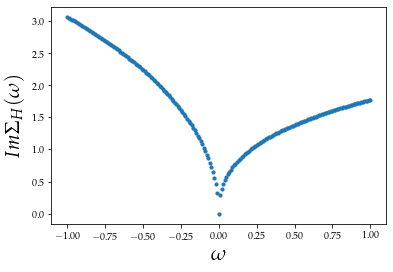

In [27]:
reg100 = Bubble(h5py.File('quarticReal/frequencyDependenceFirstRegularized100.h5','r'))
reg100.plotSelfEnergy()

In [9]:
foo=Bubble(h5py.File('quarticReal/frequencyDependenceSecondTerm.h5','r'))

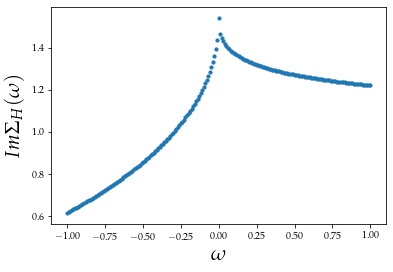

In [10]:
foo.plotSelfEnergy()

In [38]:
old=Bubble(h5py.File('quarticReal/frequencyOld.h5','r'))

In [39]:
new=Bubble(h5py.File('quarticReal/frequencyNew.h5','r'))

In [58]:
newq=Bubble(h5py.File('quarticReal/frequencyNewQuadratic.h5','r'))

In [74]:
new1=Bubble(h5py.File('quarticReal/frequencyNewQ7.h5','r'))

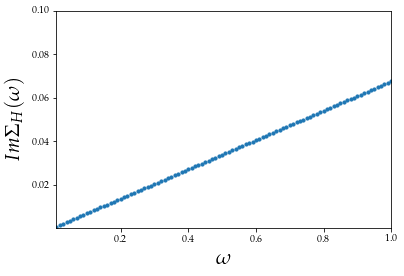

In [75]:
new1.plotSelfEnergy()

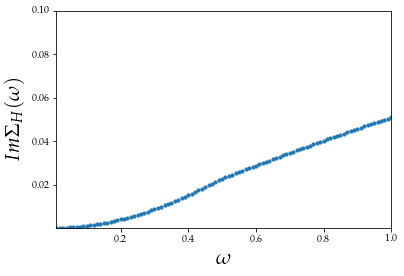

In [59]:
newq.plotSelfEnergy()

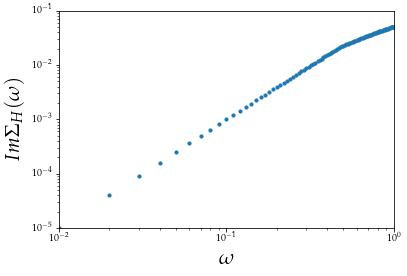

In [40]:
new.plotSelfEnergy()

In [45]:
freqs = []
SE = []
for i in range(len(new.SEPos)-1):
    SE.append(abs(new.SEPos[i+1]))
    freqs.append(new.freqs[i+1])

In [47]:
len(SE)

100

In [50]:
logD = []
x = []
for i in range(len(SE)-1):
    a = math.log(abs(SE[i+1]))-math.log(abs(SE[i]))
    b = math.log(abs(freqs[i+1]))-math.log(abs(freqs[i]))
    logD.append(a/b)
    x.append(abs(freqs[i]))

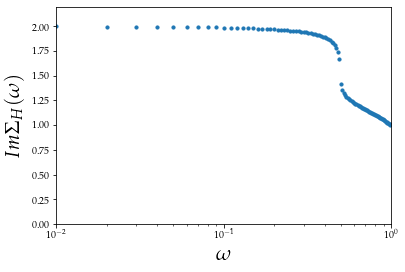

In [54]:
plt.scatter(x,logD,s=10)
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma_H(\omega)$',fontsize=20)
plt.xlim([0.01,1])
plt.ylim([0.0,2.2])
plt.xscale('log')

In [ ]:
arr = []
for i in range(len(x)-1):
    if SE[i]==0:
        continue
    else:
        a = math.log(abs(SE[i+1]))-math.log(abs(SE[i]))
        b = math.log(abs(x[i+1]))-math.log(abs(x[i]))
        if b==0:
            print(x[i])
        else:
            arr.append(a/b)

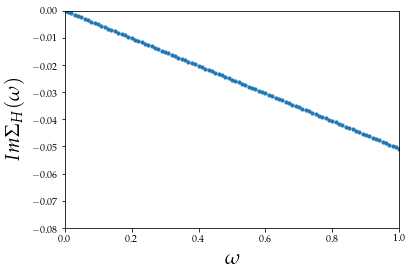

In [11]:
old.plotSelfEnergy()

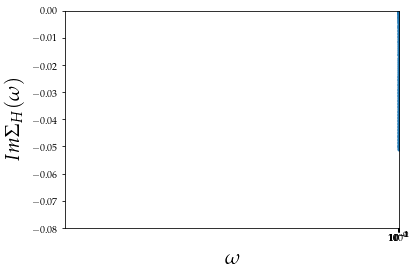

In [16]:
new.plotSelfEnergy()

In [22]:
len(trial1.freqs)

201

In [23]:
freqsneg = []
SEneg = []
for i in range(100):
    freqsneg.append(trial1.freqs[i])
    SEneg.append(trial1.SEPos[i])
freqspos = []
SEpos = []
for i in range(101,201):
    freqspos.append(trial1.freqs[i])
    SEpos.append(trial1.SEPos[i])

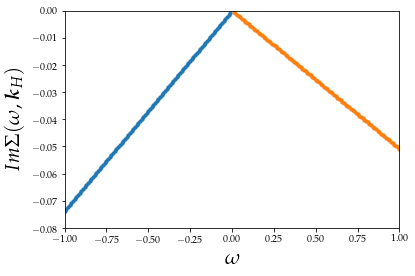

In [25]:
plt.scatter(freqsneg,SEneg,s=10)
plt.scatter(freqspos,SEpos,s=10)
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma(\omega,\boldsymbol{k}_H)$',fontsize=20)
plt.xlim([-1,1])
plt.ylim([-0.08,0])
plt.savefig('Documents/figs/quarticImagSelfEnergyFrequency.pdf',bbox_inches="tight")
plt.show()

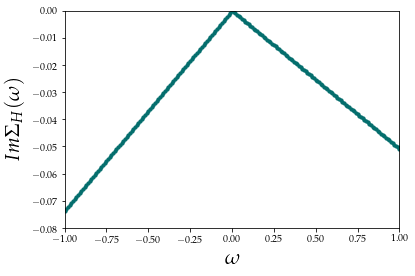

In [6]:
trial1.plotSelfEnergy()

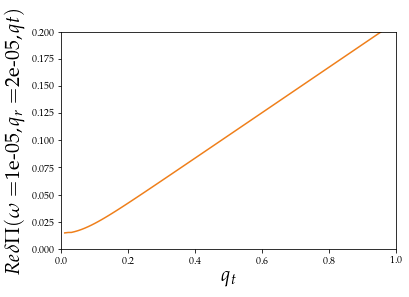

In [6]:
trial1.tangentialRealPlot()

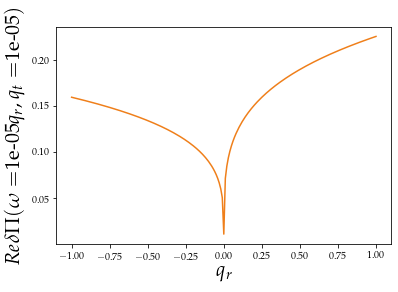

In [7]:
trial1.radialRealPlot()

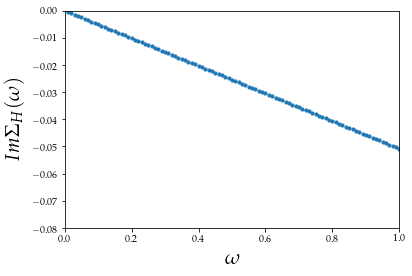

In [8]:
trial1.positiveSelfEnergy()

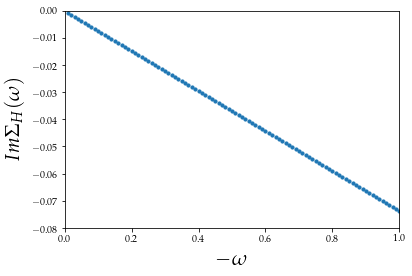

In [9]:
trial1.negativeSelfEnergy()

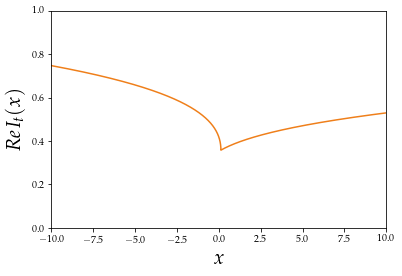

In [23]:
trial1.scalingPlusReal()

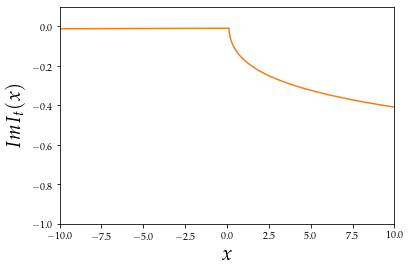

In [24]:
trial1.scalingPlusImag()

In [7]:
for i in range(5):
    print(trial1.SENeg[100-i])

-0.0732384360439328
-0.07251330300913593
-0.07178816996891513
-0.0710630369667062
-0.07033790391955018


In [49]:
len(trial1.freqs)

101

In [50]:
trial1.freqs[4]

0.05

In [7]:
nfreqs = []
for i in range(len(trial1.freqs)):
    nfreqs.append((-1)*trial1.freqs[i])

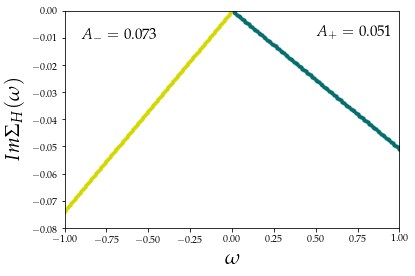

In [10]:
plt.scatter(trial1.freqs,trial1.SEPos,s=10,label = '$A_+ = 0.051$',color = '#046E6D')
plt.scatter(nfreqs,trial1.SENeg,s=10,label = '$A_- = 0.073$',color = '#D3D800')
plt.xlabel(r'$\omega$',fontsize=20)
plt.ylabel(r'$Im\Sigma_H(\omega)$',fontsize=20)
plt.xlim([-1,1])
plt.ylim([-0.08,0])
plt.text(0.5, -0.01, '$A_+ = 0.051$', fontsize = 15)
plt.text(-0.9, -0.01, '$A_- = 0.073$', fontsize = 15)
plt.savefig('Documents/figs/quarticImagSelfEnergy.pdf',bbox_inches="tight")
plt.show()

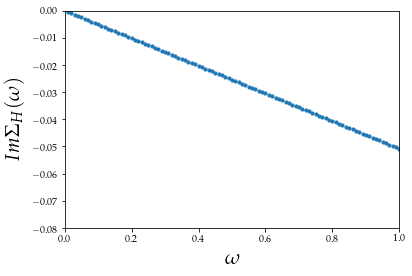

In [42]:
trial1.positiveSelfEnergy()

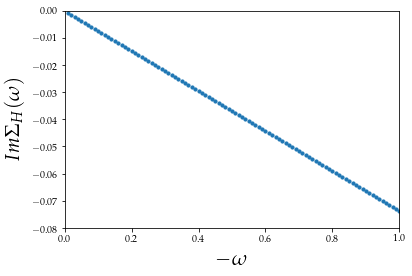

In [43]:
trial1.negativeSelfEnergy()

In [210]:
bubble9=Bubble(h5py.File('quarticReal/Bubble1.h5','r'))

No handles with labels found to put in legend.


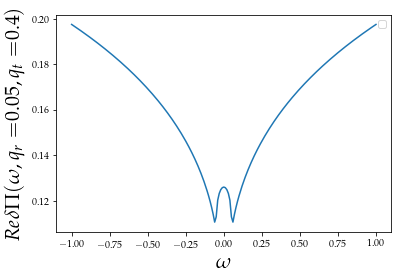

In [202]:
bubble9.freqRealPlot()

No handles with labels found to put in legend.


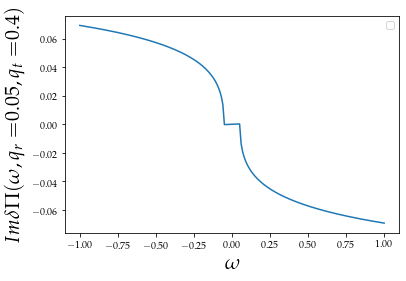

In [203]:
bubble9.freqImagPlot()

No handles with labels found to put in legend.


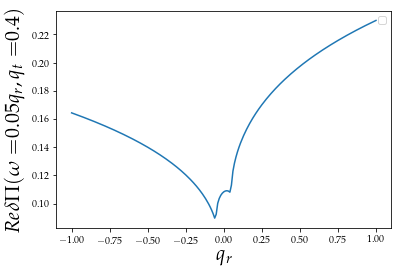

In [204]:
bubble9.radialRealPlot()

No handles with labels found to put in legend.


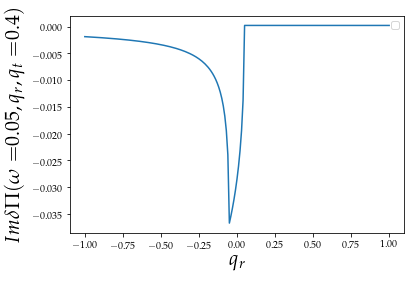

In [205]:
bubble9.radialImagPlot()

No handles with labels found to put in legend.


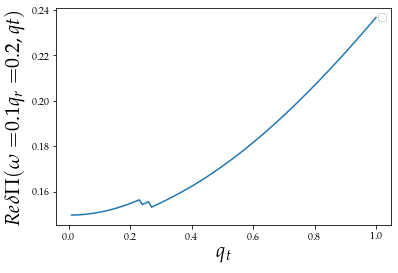

In [206]:
bubble9.tangentialRealPlot()
#steps occur at switching points where series expansion instead of interpolation starts. Reasonably smooth

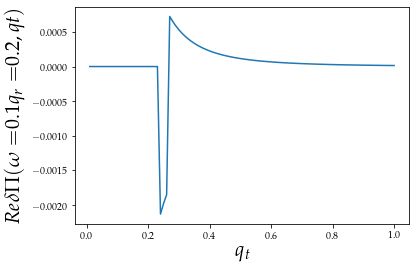

In [207]:
bubble9.tangentialImagPlot()

In [51]:
class Data1:
    def __init__(self, file):
        #self.savefigs = True
        self.valneg = file['ScalingFunction/Variable_neg']
        self.valpos = file['ScalingFunction/Variable_pos']
        self.valtang = file['ScalingFunction/Variable_tang']
        self.negBubble = file['ScalingFunction/polarization_neg']
        self.posBubble = file['ScalingFunction/polarization_pos']
        self.tangBubble = file['ScalingFunction/polarization_tang']
        self.ar = file['ScalingFunction'].attrs['Radial Exponent']
        self.at = file['ScalingFunction'].attrs['Tangential Exponent']
        self.uv = file['ScalingFunction'].attrs['Upper Cutoff']
        self.ir = file['ScalingFunction'].attrs['Lower Cutoff']
        self.b = file['ScalingFunction'].attrs['b']
        self.c = file['ScalingFunction'].attrs['c']
        self.prec = file['ScalingFunction'].attrs['Precision']
        self.steps = file['ScalingFunction'].attrs['Steps']
        self.qr = file['BubbleTest/qr_vector']
        self.qt = file['BubbleTest/qt_vector']
        self.bubbleqr = file['BubbleTest/bubble_qr']
        self.bubbleqt_plus = file['BubbleTest/bubble_qt_plus']
        self.bubbleqt_minus = file['BubbleTest/bubble_qt_minus']
        self.x = file['BubbleTest/x_vector']
        self.itx = file['BubbleTest/itx_vector']
        self.factorCutoff = file['BubbleTest'].attrs['Upper limit prefactor integral']
        self.gridExt = file['BubbleTest'].attrs['last grid point']
        self.qt_sample = file['BubbleTest'].attrs['qt Sample']
        self.qr_plus_sample = file['BubbleTest'].attrs['qr plus Sample']
        self.qr_minus_sample = file['BubbleTest'].attrs['qr minus Sample']
        self.krpos = file['SelfEnergy/kr_vector_pos']
        self.krneg = file['SelfEnergy/kr_vector_neg']
        self.ktpos = file['SelfEnergy/kt_vector_pos']
        self.ktneg = file['SelfEnergy/kt_vector_neg']
        self.seRadialPos = file['SelfEnergy/seRadialPos']
        self.seRadialNeg = file['SelfEnergy/seRadialNeg']
        self.seTangentialPos = file['SelfEnergy/seTangentialPos']
        self.seTangentialNeg = file['SelfEnergy/seTangentialNeg']
        self.kr_neg_sample = file['SelfEnergy'].attrs['kr neg Sample']
        self.kr_pos_sample = file['SelfEnergy'].attrs['kr pos Sample']
        self.kt_neg_sample = file['SelfEnergy'].attrs['kt neg Sample']
        self.kt_pos_sample = file['SelfEnergy'].attrs['kt pos Sample']
        self.lowerq = file['SelfEnergy'].attrs['Lower bound q Integral']
        self.upperq = file['SelfEnergy'].attrs['Upper bound q Integral']

In [52]:
bubble14 = Data1(h5py.File('quarticReal/genericCalculation14.h5','r'))

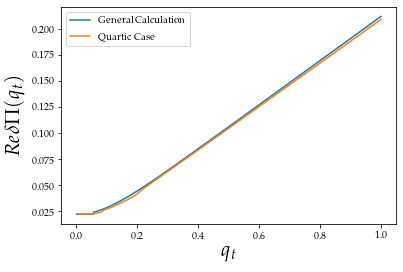

In [89]:
plt.plot(bubble14.qt,bubble14.bubbleqt_plus, label = 'General Calculation')
plt.plot(bubble8.qt,bubble8.tangReal, label = 'Quartic Case')
plt.xlabel(r'$q_t$', fontsize=20)
plt.ylabel(r'$Re\delta\Pi(q_t)$', fontsize=20)
plt.legend()
#plt.xlim([-self.lim,self.lim])
#plt.ylim([0.0,1.0])
plt.savefig('Documents/figs/quarticRealTangential.pdf',bbox_inches="tight")
plt.show()

In [56]:
bubble14.qr_plus_sample

0.0001

In [57]:
bubble14.qt_sample

0.001